In [1]:
import pandas as pd

In [2]:
df=pd.read_csv(r"C:\Users\Siddhant Nijhawan\Downloads\Email-project\email (1)\email_table.csv")

In [3]:
df

,email_id,email_text,email_version,hour,weekday,user_country,user_past_purchases
0,85120,short_email,personalized,2,Sunday,US,5
1,966622,long_email,personalized,12,Sunday,UK,2
2,777221,long_email,personalized,11,Wednesday,US,2
3,493711,short_email,generic,6,Monday,UK,1
4,106887,long_email,generic,14,Monday,US,6
...,...,...,...,...,...,...,...
99995,803504,short_email,personalized,4,Monday,US,5
99996,899722,long_email,personalized,7,Saturday,US,1
99997,449610,long_email,personalized,11,Saturday,UK,6
99998,72497,short_email,generic,10,Monday,UK,0


In [5]:
df.isnull().sum()

email_id               0
email_text             0
email_version          0
hour                   0
weekday                0
user_country           0
user_past_purchases    0
dtype: int64

In [8]:
df1=pd.read_csv(r"C:\Users\Siddhant Nijhawan\Downloads\Email-project\email (1)\email_opened_table.csv")

In [9]:
df1

,email_id
0,284534
1,609056
2,220820
3,905936
4,164034
...,...
10340,990213
10341,918210
10342,200299
10343,211104


In [10]:
df2=pd.read_csv(r"C:\Users\Siddhant Nijhawan\Downloads\Email-project\email (1)\link_clicked_table.csv")

In [11]:
df2

,email_id
0,609056
1,870980
2,935124
3,158501
4,177561
...,...
2114,873162
2115,435454
2116,206772
2117,742967


In [12]:
df1.rename(columns={"email_id":"open_email_id"},inplace=True)

In [13]:
df2.rename(columns={"email_id":"link_clicked_email_id"},inplace=True)

In [14]:
df1

,open_email_id
0,284534
1,609056
2,220820
3,905936
4,164034
...,...
10340,990213
10341,918210
10342,200299
10343,211104


In [27]:
import numpy as np
df1["open_email_id"].nunique()

10345

In [15]:
df2

,link_clicked_email_id
0,609056
1,870980
2,935124
3,158501
4,177561
...,...
2114,873162
2115,435454
2116,206772
2117,742967


In [29]:
import numpy as np
df2["link_clicked_email_id"].nunique()

2119

In [16]:
df

,email_id,email_text,email_version,hour,weekday,user_country,user_past_purchases
0,85120,short_email,personalized,2,Sunday,US,5
1,966622,long_email,personalized,12,Sunday,UK,2
2,777221,long_email,personalized,11,Wednesday,US,2
3,493711,short_email,generic,6,Monday,UK,1
4,106887,long_email,generic,14,Monday,US,6
...,...,...,...,...,...,...,...
99995,803504,short_email,personalized,4,Monday,US,5
99996,899722,long_email,personalized,7,Saturday,US,1
99997,449610,long_email,personalized,11,Saturday,UK,6
99998,72497,short_email,generic,10,Monday,UK,0


In [30]:
# Add 'opened' flag: 1 if the email was opened, 0 otherwise
df["opened"] = df["email_id"].isin(df1["open_email_id"]).astype(int)

# Add 'clicked' flag: 1 if the email link was clicked, 0 otherwise
df["clicked"] = df["email_id"].isin(df2["link_clicked_email_id"]).astype(int)

In [31]:
df

,email_id,email_text,email_version,hour,weekday,user_country,user_past_purchases,opened,clicked
0,85120,short_email,personalized,2,Sunday,US,5,0,0
1,966622,long_email,personalized,12,Sunday,UK,2,1,1
2,777221,long_email,personalized,11,Wednesday,US,2,0,0
3,493711,short_email,generic,6,Monday,UK,1,0,0
4,106887,long_email,generic,14,Monday,US,6,0,0
...,...,...,...,...,...,...,...,...,...
99995,803504,short_email,personalized,4,Monday,US,5,0,0
99996,899722,long_email,personalized,7,Saturday,US,1,0,0
99997,449610,long_email,personalized,11,Saturday,UK,6,0,0
99998,72497,short_email,generic,10,Monday,UK,0,0,0


In [32]:
df.to_csv("master_email_campaign.csv", index=False)


In [33]:
df

,email_id,email_text,email_version,hour,weekday,user_country,user_past_purchases,opened,clicked
0,85120,short_email,personalized,2,Sunday,US,5,0,0
1,966622,long_email,personalized,12,Sunday,UK,2,1,1
2,777221,long_email,personalized,11,Wednesday,US,2,0,0
3,493711,short_email,generic,6,Monday,UK,1,0,0
4,106887,long_email,generic,14,Monday,US,6,0,0
...,...,...,...,...,...,...,...,...,...
99995,803504,short_email,personalized,4,Monday,US,5,0,0
99996,899722,long_email,personalized,7,Saturday,US,1,0,0
99997,449610,long_email,personalized,11,Saturday,UK,6,0,0
99998,72497,short_email,generic,10,Monday,UK,0,0,0


In [37]:
open_rate = (df['opened'].sum() / len(df)) * 100
print(f"Open Rate: {open_rate:.2f}%")
print("How good your subject line/timing was -- (open rate)")

Open Rate: 10.35%
How good your subject line/timing was (open rate)


In [38]:
click_rate = (df['clicked'].sum() / len(df)) * 100
print(f"Click Rate: {click_rate:.2f}%")
print("Overall impact -- (click rate)")

Click Rate: 2.12%
Overall impact -- (click rate)


In [40]:

ctr = (df['clicked'].sum() / df['opened'].sum()) * 100 if df['opened'].sum() != 0 else 0
print(f"Click Through Rate (CTR): {ctr:.2f}%")
print("How compelling your content/link was -- (CTR)")

Click Through Rate (CTR): 20.48%
How compelling your content/link was -- (CTR)


In [41]:
df

,email_id,email_text,email_version,hour,weekday,user_country,user_past_purchases,opened,clicked
0,85120,short_email,personalized,2,Sunday,US,5,0,0
1,966622,long_email,personalized,12,Sunday,UK,2,1,1
2,777221,long_email,personalized,11,Wednesday,US,2,0,0
3,493711,short_email,generic,6,Monday,UK,1,0,0
4,106887,long_email,generic,14,Monday,US,6,0,0
...,...,...,...,...,...,...,...,...,...
99995,803504,short_email,personalized,4,Monday,US,5,0,0
99996,899722,long_email,personalized,7,Saturday,US,1,0,0
99997,449610,long_email,personalized,11,Saturday,UK,6,0,0
99998,72497,short_email,generic,10,Monday,UK,0,0,0


In [42]:
import pandas as pd
import plotly.express as px
import matplotlib.pyplot as plt


In [43]:

ctr_overall = df['clicked'].sum() / len(df)
print(f"Click-Through Rate (CTR): {ctr_overall:.2%}")


Click-Through Rate (CTR): 2.12%


In [44]:
ctr_email_text = df.groupby('email_text')['clicked'].mean().reset_index()
fig = px.bar(ctr_email_text, x='email_text', y='clicked', title='CTR by Email Text (Short vs Long)', labels={'clicked': 'CTR'})
fig.show()


In [45]:
ctr_email_version = df.groupby('email_version')['clicked'].mean().reset_index()
fig = px.bar(ctr_email_version, x='email_version', y='clicked', title='CTR by Email Version (Personalized vs Generic)', labels={'clicked': 'CTR'})
fig.show()


In [46]:
ctr_hour = df.groupby('hour')['clicked'].mean().reset_index()
fig = px.line(ctr_hour, x='hour', y='clicked', title='CTR by Hour Sent', markers=True, labels={'clicked': 'CTR'})
fig.show()


In [47]:
ctr_country = df.groupby('user_country')['clicked'].mean().reset_index()
fig = px.bar(ctr_country, x='user_country', y='clicked', title='CTR by Country', labels={'clicked': 'CTR'})
fig.show()


In [48]:
weekday_order = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
df['weekday'] = pd.Categorical(df['weekday'], categories=weekday_order, ordered=True)

ctr_weekday = df.groupby('weekday')['clicked'].mean().reset_index()
fig = px.line(ctr_weekday, x='weekday', y='clicked', title='CTR by Weekday', markers=True, labels={'clicked': 'CTR'})
fig.show()


C:\Users\Siddhant Nijhawan\AppData\Local\Temp\ipykernel_249344\288080020.py:4: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



In [49]:
# Histogram of purchases
fig = px.histogram(df, x='user_past_purchases', title='Distribution of User Past Purchases')
fig.show()

# CTR vs Past Purchases
ctr_purchases = df.groupby('user_past_purchases')['clicked'].mean().reset_index()
fig = px.line(ctr_purchases, x='user_past_purchases', y='clicked', title='CTR by User Past Purchases', markers=True, labels={'clicked': 'CTR'})
fig.show()



--- Email Content Analysis ---

Performance by email text length:
               opened   clicked
email_text                     
long_email   0.091177  0.018538
short_email  0.115860  0.023872

Performance by email personalization:
                 opened   clicked
email_version                    
generic        0.079348  0.015137
personalized   0.127754  0.027294

Top 5 hours by click rate:
        opened   clicked
hour                    
23    0.082759  0.041379
24    0.159420  0.028986
10    0.132396  0.028240
11    0.126554  0.027128
9     0.125689  0.025794

Performance by weekday:
             opened   clicked
weekday                      
Monday     0.116062  0.022906
Tuesday    0.120484  0.024889
Wednesday  0.120278  0.027620
Thursday   0.118442  0.024445
Friday     0.074134  0.014037
Saturday   0.087652  0.017846
Sunday     0.087649  0.016751

Performance by country:
                opened   clicked
user_country                    
ES            0.039129  0.008327
FR      

C:\Users\Siddhant Nijhawan\AppData\Local\Temp\ipykernel_249344\4059554695.py:23: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.

C:\Users\Siddhant Nijhawan\AppData\Local\Temp\ipykernel_249344\4059554695.py:37: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



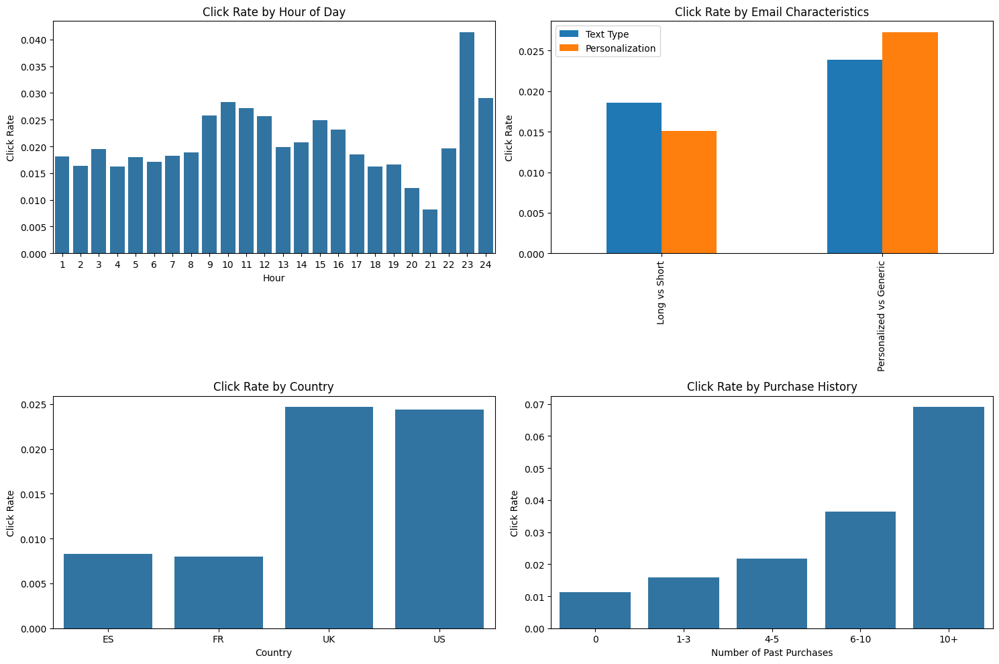

In [56]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

# 1. Email characteristics analysis
print("\n--- Email Content Analysis ---")
# Text length impact
text_performance = df.groupby('email_text')[['opened', 'clicked']].mean()
print("\nPerformance by email text length:")
print(text_performance)

# Personalization impact
version_performance = df.groupby('email_version')[['opened', 'clicked']].mean()
print("\nPerformance by email personalization:")
print(version_performance)

# 2. Timing analysis
hour_performance = df.groupby('hour')[['opened', 'clicked']].mean().sort_values(by='clicked', ascending=False)
print("\nTop 5 hours by click rate:")
print(hour_performance.head(5))

weekday_performance = df.groupby('weekday')[['opened', 'clicked']].mean()
print("\nPerformance by weekday:")
print(weekday_performance)

# 3. User characteristic analysis
country_performance = df.groupby('user_country')[['opened', 'clicked']].mean()
print("\nPerformance by country:")
print(country_performance)

# For purchase history, let's create some segments
df['purchase_segment'] = pd.cut(df['user_past_purchases'], 
                                bins=[0, 1, 3, 5, 10, float('inf')],
                                labels=['0', '1-3', '4-5', '6-10', '10+'])

purchase_performance = df.groupby('purchase_segment')[['opened', 'clicked']].mean()
print("\nPerformance by purchase history:")
print(purchase_performance)

# 4. Visualization of key insights
plt.figure(figsize=(15, 10))

# Plot 1: Click rate by hour
plt.subplot(2, 2, 1)
sns.barplot(x=hour_performance.index, y=hour_performance['clicked'])
plt.title('Click Rate by Hour of Day')
plt.xlabel('Hour')
plt.ylabel('Click Rate')

# Plot 2: Email characteristics
plt.subplot(2, 2, 2)
combined_df = pd.DataFrame({
    'Text Type': text_performance['clicked'].values,
    'Personalization': version_performance['clicked'].values
})
combined_df.index = ['Long vs Short', 'Personalized vs Generic']
combined_df.plot(kind='bar', ax=plt.gca())
plt.title('Click Rate by Email Characteristics')
plt.ylabel('Click Rate')

# Plot 3: Performance by country
plt.subplot(2, 2, 3)
sns.barplot(x=country_performance.index, y=country_performance['clicked'])
plt.title('Click Rate by Country')
plt.xlabel('Country')
plt.ylabel('Click Rate')

# Plot 4: Performance by purchase history
plt.subplot(2, 2, 4)
sns.barplot(x=purchase_performance.index, y=purchase_performance['clicked'])
plt.title('Click Rate by Purchase History')
plt.xlabel('Number of Past Purchases')
plt.ylabel('Click Rate')

plt.tight_layout()
plt.savefig('email_campaign_analysis.png')
plt.show()

In [53]:
df["user_country"].nunique()

4

In [54]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import OneHotEncoder, StandardScaler
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import classification_report, confusion_matrix, roc_auc_score

In [1]:
import pandas as pd
df=pd.read_csv(r"C:\Users\Siddhant Nijhawan\Downloads\Email-project\master_email_campaign.csv")

In [2]:
df

,email_id,email_text,email_version,hour,weekday,user_country,user_past_purchases,opened,clicked
0,85120,short_email,personalized,2,Sunday,US,5,0,0
1,966622,long_email,personalized,12,Sunday,UK,2,1,1
2,777221,long_email,personalized,11,Wednesday,US,2,0,0
3,493711,short_email,generic,6,Monday,UK,1,0,0
4,106887,long_email,generic,14,Monday,US,6,0,0
...,...,...,...,...,...,...,...,...,...
99995,803504,short_email,personalized,4,Monday,US,5,0,0
99996,899722,long_email,personalized,7,Saturday,US,1,0,0
99997,449610,long_email,personalized,11,Saturday,UK,6,0,0
99998,72497,short_email,generic,10,Monday,UK,0,0,0


In [3]:
import pandas as pd
import numpy as np
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import OneHotEncoder, StandardScaler
from sklearn.pipeline import Pipeline
from sklearn.model_selection import train_test_split

# -----------------------------
# FUNCTION TO PREPARE FEATURES
# -----------------------------
def prepare_features_combined(df):
    # Step 1: Make a copy to avoid modifying the original dataframe
    data = df.copy()

    # ----------------------------------------
    # Step 2: Cyclical Encoding for "hour"
    # ----------------------------------------
    # Hours are cyclical (23 is closer to 0 than to 20). So we use sine and cosine transforms.
    data['hour_sin'] = np.sin(2 * np.pi * data['hour'] / 24)
    data['hour_cos'] = np.cos(2 * np.pi * data['hour'] / 24)

    # Drop raw hour after encoding it
    data.drop('hour', axis=1, inplace=True)

    # ----------------------------------------
    # Step 3: Log Transform for Skewed Numeric
    # ----------------------------------------
    # Many users may have 0–1 purchases, few may have 10+. We log-transform to reduce skew.
    data['log_purchases'] = np.log1p(data['user_past_purchases'])

    # Drop raw version after transformation
    data.drop('user_past_purchases', axis=1, inplace=True)

    # ----------------------------------------
    # Step 4: Interaction Features (optional but powerful)
    # ----------------------------------------
    # If personalized emails are more effective for loyal customers, combine those effects:
    data['email_version_personalized'] = (data['email_version'] == 'personalized').astype(int)
    data['interaction_personalized_loyal'] = data['email_version_personalized'] * data['log_purchases']

    # ----------------------------------------
    # Step 5: Define Columns to Encode
    # ----------------------------------------
    categorical_cols = ['email_text', 'email_version', 'weekday', 'user_country']
    numeric_cols = ['log_purchases', 'hour_sin', 'hour_cos', 'interaction_personalized_loyal']

    # ----------------------------------------
    # Step 6: One-Hot Encode Categorical Variables + Standard Scale Numeric
    # ----------------------------------------
    preprocessor = ColumnTransformer(transformers=[
        ('cat', OneHotEncoder(drop='first'), categorical_cols),
        ('num', StandardScaler(), numeric_cols)
    ])

    # ----------------------------------------
    # Step 7: Features and Target Split
    # ----------------------------------------
    X = data.drop(columns=['email_id', 'opened', 'clicked'])  # Features
    y = data['clicked']  # Target

    # Apply preprocessing pipeline
    X_processed = preprocessor.fit_transform(X)

    # Get feature names after encoding (for interpretability)
    cat_features = preprocessor.named_transformers_['cat'].get_feature_names_out(categorical_cols)
    feature_names = list(cat_features) + numeric_cols

    # Return everything needed for modeling
    return X_processed, y, feature_names, preprocessor


In [5]:
X_processed, y, feature_names, preprocessor = prepare_features_combined(df)

# Show final feature names for model explainability
print("Final Features Used in Model:")
print(feature_names)

Final Features Used in Model:
['email_text_short_email', 'email_version_personalized', 'weekday_Monday', 'weekday_Saturday', 'weekday_Sunday', 'weekday_Thursday', 'weekday_Tuesday', 'weekday_Wednesday', 'user_country_FR', 'user_country_UK', 'user_country_US', 'log_purchases', 'hour_sin', 'hour_cos', 'interaction_personalized_loyal']


In [6]:
# Count the number of 0s and 1s
print("Class distribution (clicked = 1 is positive class):")
print(df['clicked'].value_counts())

# Percentage distribution
print("\nClass distribution in %:")
print(df['clicked'].value_counts(normalize=True) * 100)


Class distribution (clicked = 1 is positive class):
clicked
0    97881
1     2119
Name: count, dtype: int64

Class distribution in %:
clicked
0    97.881
1     2.119
Name: proportion, dtype: float64


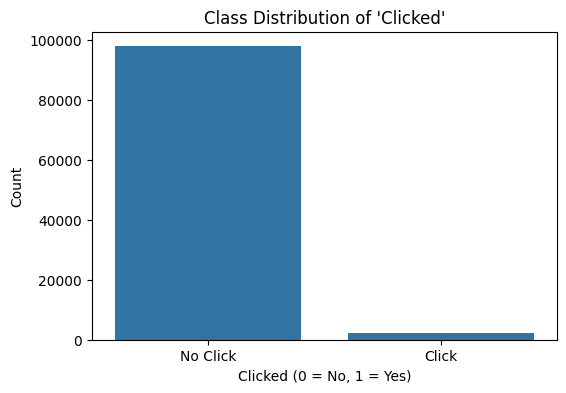

In [7]:
import matplotlib.pyplot as plt
import seaborn as sns

plt.figure(figsize=(6, 4))
sns.countplot(x='clicked', data=df)
plt.title("Class Distribution of 'Clicked'")
plt.xlabel("Clicked (0 = No, 1 = Yes)")
plt.ylabel("Count")
plt.xticks([0, 1], ['No Click', 'Click'])
plt.show()


In [9]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split, GridSearchCV, StratifiedKFold
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import (roc_auc_score, precision_recall_curve, average_precision_score, 
                           f1_score, classification_report, confusion_matrix, roc_curve, auc)
import xgboost as xgb
import lightgbm as lgb
from sklearn.calibration import CalibratedClassifierCV


In [10]:
# Split data into training, validation, and testing sets
X_train, X_temp, y_train, y_temp = train_test_split(X_processed, y, test_size=0.3, random_state=42, stratify=y)
X_val, X_test, y_val, y_test = train_test_split(X_temp, y_temp, test_size=0.5, random_state=42, stratify=y_temp)



In [11]:
n_samples = len(y_train)
n_positive = sum(y_train)
n_negative = n_samples - n_positive
weight_for_0 = 1.0
weight_for_1 = n_negative / n_positive  # Higher weight for minority class
class_weights = {0: weight_for_0, 1: weight_for_1}

print(f"Class distribution in training set: {n_positive} positives, {n_negative} negatives")
print(f"Class weights: {class_weights}")


Class distribution in training set: 1483 positives, 68517 negatives
Class weights: {0: 1.0, 1: 46.20161834120027}


In [12]:
def find_optimal_threshold(y_true, y_pred_proba):
    """Find the optimal threshold that maximizes F1 score"""
    precision, recall, thresholds = precision_recall_curve(y_true, y_pred_proba)
    # Calculate F1 score for each threshold
    f1_scores = 2 * recall * precision / (recall + precision + 1e-10)  # Avoid division by zero
    # Find the threshold with the highest F1 score
    optimal_idx = np.argmax(f1_scores)
    if optimal_idx < len(thresholds):  # Check if index is valid
        return thresholds[optimal_idx]
    else:
        return 0.5  # Default threshold if optimal not found

In [13]:
def evaluate_model(model, X, y_true, threshold=0.5, name="Model"):
    """Evaluate model performance with multiple metrics"""
    y_pred_proba = model.predict_proba(X)[:, 1]
    y_pred = (y_pred_proba >= threshold).astype(int)
    
    # Calculate metrics
    roc_auc = roc_auc_score(y_true, y_pred_proba)
    pr_auc = average_precision_score(y_true, y_pred_proba)
    f1 = f1_score(y_true, y_pred)
    
    # Print results
    print(f"\n--- {name} Evaluation ---")
    print(f"ROC AUC: {roc_auc:.4f}")
    print(f"PR AUC: {pr_auc:.4f}")
    print(f"F1 Score (threshold={threshold:.4f}): {f1:.4f}")
    print(f"Classification Report:\n{classification_report(y_true, y_pred)}")
    
    # Confusion Matrix
    cm = confusion_matrix(y_true, y_pred)
    plt.figure(figsize=(6, 5))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', 
                xticklabels=['Not Clicked', 'Clicked'],
                yticklabels=['Not Clicked', 'Clicked'])
    plt.title(f'Confusion Matrix - {name}')
    plt.ylabel('True Label')
    plt.xlabel('Predicted Label')
    plt.tight_layout()
    plt.show()
    
    # ROC Curve
    fpr, tpr, _ = roc_curve(y_true, y_pred_proba)
    plt.figure(figsize=(6, 5))
    plt.plot(fpr, tpr, lw=2, label=f'ROC curve (area = {roc_auc:.4f})')
    plt.plot([0, 1], [0, 1], 'k--', lw=2)
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title(f'ROC Curve - {name}')
    plt.legend(loc="lower right")
    plt.grid(True)
    plt.show()
    
    # PR Curve
    precision, recall, _ = precision_recall_curve(y_true, y_pred_proba)
    plt.figure(figsize=(6, 5))
    plt.plot(recall, precision, lw=2, label=f'PR curve (area = {pr_auc:.4f})')
    plt.xlabel('Recall')
    plt.ylabel('Precision')
    plt.title(f'Precision-Recall Curve - {name}')
    plt.legend(loc="upper right")
    plt.grid(True)
    plt.show()
    
    return {
        'model': model,
        'roc_auc': roc_auc,
        'pr_auc': pr_auc,
        'f1': f1,
        'threshold': threshold,
        'predictions': y_pred_proba
    }

In [14]:
print("\n=== Training Logistic Regression ===")
log_param_grid = {
    'C': [0.001, 0.01, 0.1, 1, 10, 100],
    'class_weight': ['balanced', class_weights],
    'solver': ['liblinear', 'saga'],
    'penalty': ['l1', 'l2']
}



=== Training Logistic Regression ===


Fitting 5 folds for each of 48 candidates, totalling 240 fits
Best parameters: {'C': 0.1, 'class_weight': 'balanced', 'penalty': 'l1', 'solver': 'liblinear'}
Optimal threshold for Logistic Regression: 0.7679

--- Logistic Regression Evaluation ---
ROC AUC: 0.7473
PR AUC: 0.0620
F1 Score (threshold=0.7679): 0.1184
Classification Report:
              precision    recall  f1-score   support

           0       0.98      0.96      0.97     14682
           1       0.09      0.18      0.12       318

    accuracy                           0.94     15000
   macro avg       0.54      0.57      0.54     15000
weighted avg       0.96      0.94      0.95     15000



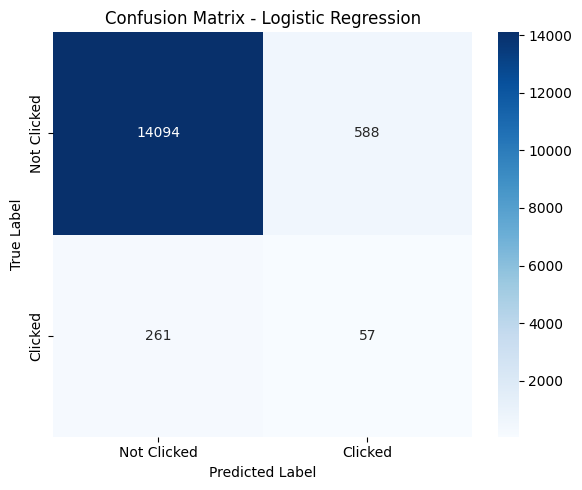

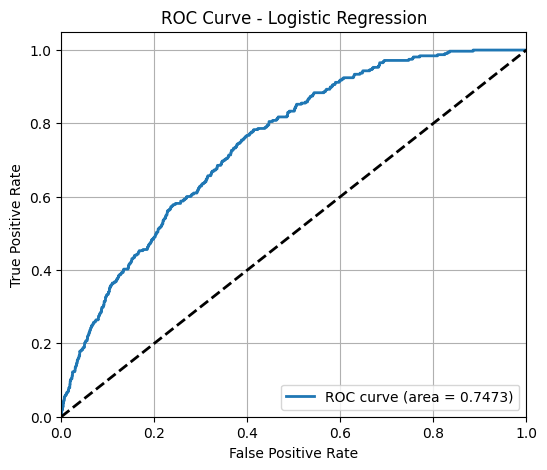

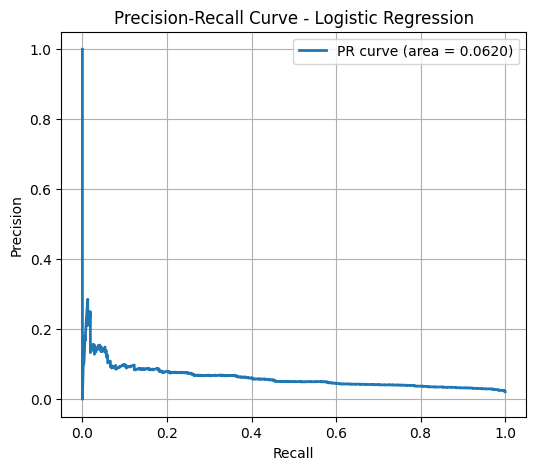

In [15]:
log_grid = GridSearchCV(
    LogisticRegression(max_iter=1000, random_state=42),
    param_grid=log_param_grid,
    scoring='average_precision',  # PR AUC is better for imbalanced classes
    cv=StratifiedKFold(5),
    verbose=1,
    n_jobs=-1
)

log_grid.fit(X_train, y_train)
print(f"Best parameters: {log_grid.best_params_}")
lr_model = log_grid.best_estimator_

# Find optimal threshold
lr_proba = lr_model.predict_proba(X_val)[:, 1]
lr_threshold = find_optimal_threshold(y_val, lr_proba)
print(f"Optimal threshold for Logistic Regression: {lr_threshold:.4f}")

# Evaluate on validation set
lr_results = evaluate_model(lr_model, X_val, y_val, threshold=lr_threshold, name="Logistic Regression")



=== Training Random Forest ===
Fitting 5 folds for each of 162 candidates, totalling 810 fits
Best parameters: {'class_weight': 'balanced', 'max_depth': 10, 'min_samples_leaf': 2, 'min_samples_split': 10, 'n_estimators': 100}
Optimal threshold for Random Forest: 0.6266

--- Random Forest Evaluation ---
ROC AUC: 0.7163
PR AUC: 0.0543
F1 Score (threshold=0.6266): 0.1149
Classification Report:
              precision    recall  f1-score   support

           0       0.98      0.94      0.96     14682
           1       0.08      0.23      0.11       318

    accuracy                           0.92     15000
   macro avg       0.53      0.59      0.54     15000
weighted avg       0.96      0.92      0.94     15000



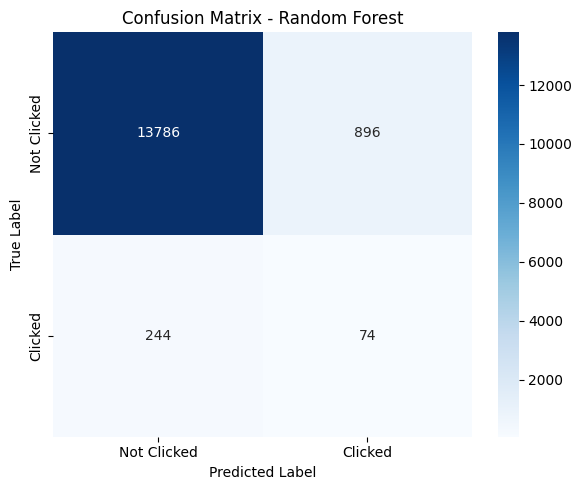

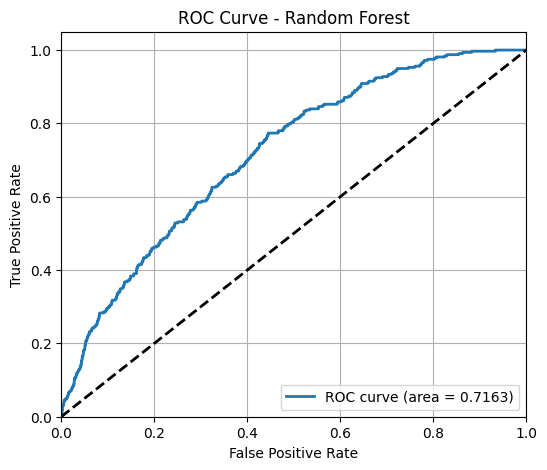

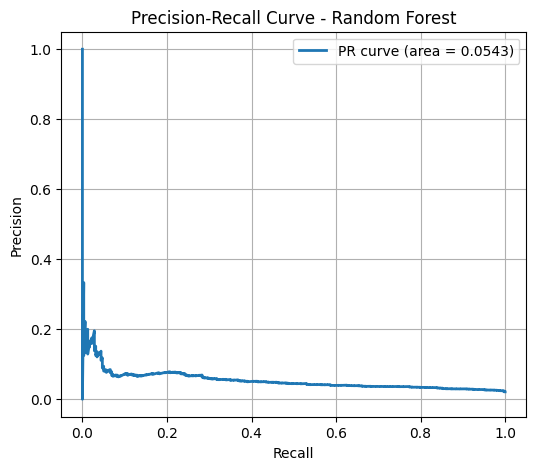

In [16]:
# 2. Random Forest with Grid Search
print("\n=== Training Random Forest ===")
rf_param_grid = {
    'n_estimators': [100, 200],
    'max_depth': [None, 10, 20],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4],
    'class_weight': ['balanced', 'balanced_subsample', class_weights]
}

rf_grid = GridSearchCV(
    RandomForestClassifier(random_state=42),
    param_grid=rf_param_grid,
    scoring='average_precision',
    cv=StratifiedKFold(5),
    verbose=1,
    n_jobs=-1
)

rf_grid.fit(X_train, y_train)
print(f"Best parameters: {rf_grid.best_params_}")
rf_model = rf_grid.best_estimator_

# Find optimal threshold
rf_proba = rf_model.predict_proba(X_val)[:, 1]
rf_threshold = find_optimal_threshold(y_val, rf_proba)
print(f"Optimal threshold for Random Forest: {rf_threshold:.4f}")

# Evaluate on validation set
rf_results = evaluate_model(rf_model, X_val, y_val, threshold=rf_threshold, name="Random Forest")




=== Training XGBoost ===
Fitting 5 folds for each of 144 candidates, totalling 720 fits


C:\Users\Siddhant Nijhawan\Downloads\Email-project\.venv\lib\site-packages\xgboost\training.py:183: UserWarning: [14:04:37] WARNING: C:\actions-runner\_work\xgboost\xgboost\src\learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)


Best parameters: {'colsample_bytree': 1.0, 'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 100, 'scale_pos_weight': 46.20161834120027, 'subsample': 1.0}
Optimal threshold for XGBoost: 0.7163

--- XGBoost Evaluation ---
ROC AUC: 0.7419
PR AUC: 0.0609
F1 Score (threshold=0.7163): 0.1182
Classification Report:
              precision    recall  f1-score   support

           0       0.98      0.94      0.96     14682
           1       0.08      0.24      0.12       318

    accuracy                           0.93     15000
   macro avg       0.53      0.59      0.54     15000
weighted avg       0.96      0.93      0.94     15000



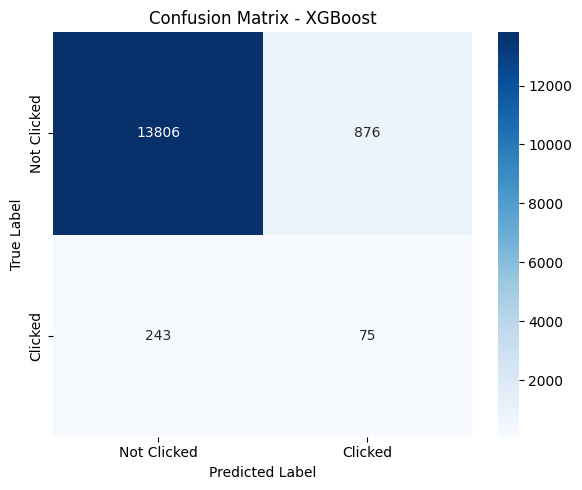

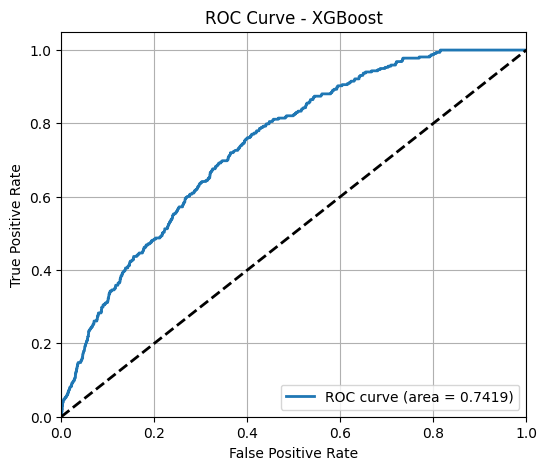

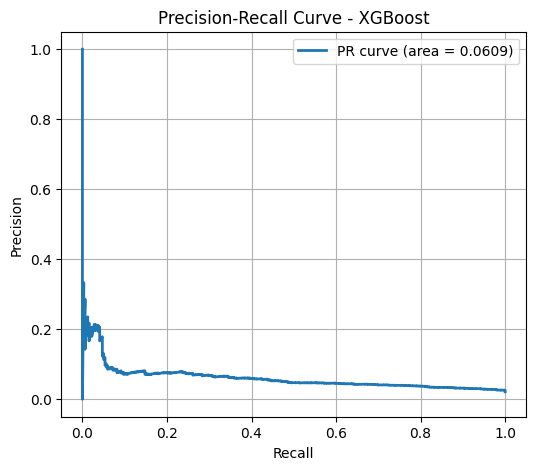

In [17]:
# 3. XGBoost with Grid Search
print("\n=== Training XGBoost ===")
xgb_param_grid = {
    'n_estimators': [100, 200],
    'max_depth': [3, 5, 7],
    'learning_rate': [0.01, 0.1, 0.2],
    'subsample': [0.8, 1.0],
    'colsample_bytree': [0.8, 1.0],
    'scale_pos_weight': [1, weight_for_1]  # Handle class imbalance
}

xgb_grid = GridSearchCV(
    xgb.XGBClassifier(random_state=42, use_label_encoder=False, eval_metric='logloss'),
    param_grid=xgb_param_grid,
    scoring='average_precision',
    cv=StratifiedKFold(5),
    verbose=1,
    n_jobs=-1
)

xgb_grid.fit(X_train, y_train)
print(f"Best parameters: {xgb_grid.best_params_}")
xgb_model = xgb_grid.best_estimator_

# Find optimal threshold
xgb_proba = xgb_model.predict_proba(X_val)[:, 1]
xgb_threshold = find_optimal_threshold(y_val, xgb_proba)
print(f"Optimal threshold for XGBoost: {xgb_threshold:.4f}")

# Evaluate on validation set
xgb_results = evaluate_model(xgb_model, X_val, y_val, threshold=xgb_threshold, name="XGBoost")



Training class distribution after SMOTE: [68517 68517]

--- Training Logistic Regression ---
Fitting 5 folds for each of 6 candidates, totalling 30 fits

--- Logistic Regression ---
ROC AUC: 0.7443 | PR AUC: 0.0619 | F1 (thr=0.79): 0.1225
              precision    recall  f1-score   support

           0       0.98      0.97      0.97     14682
           1       0.10      0.17      0.12       318

    accuracy                           0.95     15000
   macro avg       0.54      0.57      0.55     15000
weighted avg       0.96      0.95      0.96     15000



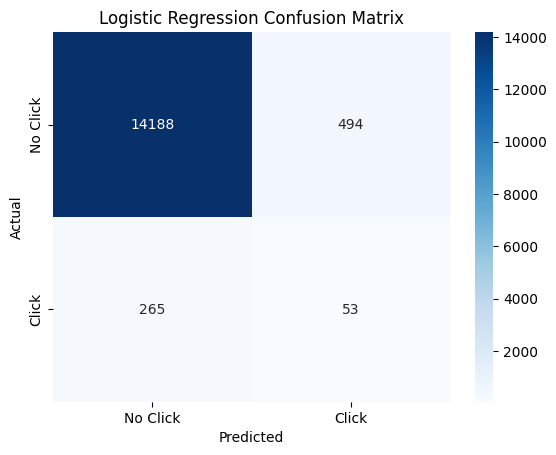


--- Training Random Forest ---
Fitting 5 folds for each of 2 candidates, totalling 10 fits

--- Random Forest ---
ROC AUC: 0.6922 | PR AUC: 0.0469 | F1 (thr=0.44): 0.0983
              precision    recall  f1-score   support

           0       0.98      0.95      0.97     14682
           1       0.07      0.16      0.10       318

    accuracy                           0.94     15000
   macro avg       0.53      0.56      0.53     15000
weighted avg       0.96      0.94      0.95     15000



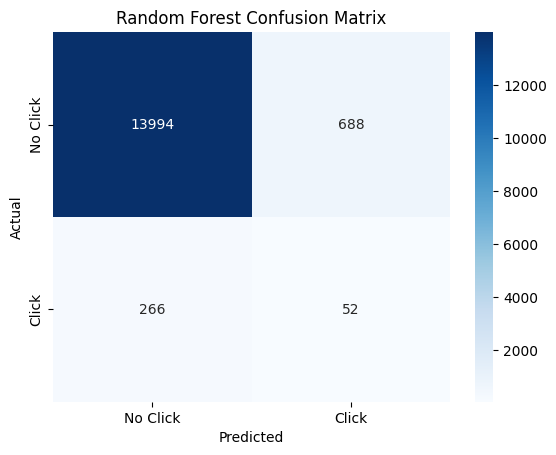


--- Training XGBoost ---
Fitting 5 folds for each of 2 candidates, totalling 10 fits


C:\Users\Siddhant Nijhawan\Downloads\Email-project\.venv\lib\site-packages\xgboost\training.py:183: UserWarning: [15:09:14] WARNING: C:\actions-runner\_work\xgboost\xgboost\src\learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)



--- XGBoost ---
ROC AUC: 0.7309 | PR AUC: 0.0555 | F1 (thr=0.38): 0.1118
              precision    recall  f1-score   support

           0       0.98      0.92      0.95     14682
           1       0.07      0.27      0.11       318

    accuracy                           0.91     15000
   macro avg       0.53      0.60      0.53     15000
weighted avg       0.96      0.91      0.93     15000



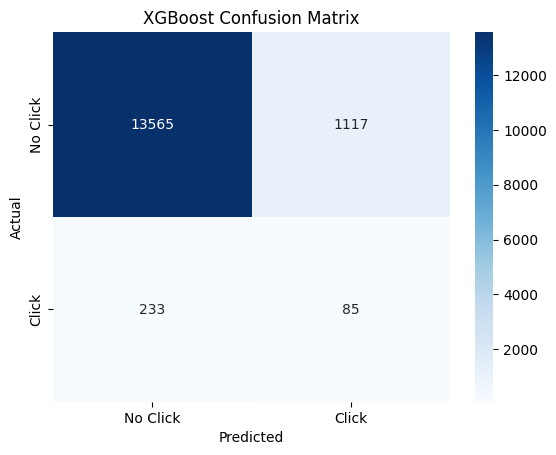


--- Training LightGBM ---
Fitting 5 folds for each of 2 candidates, totalling 10 fits
[LightGBM] [Info] Number of positive: 68517, number of negative: 68517
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.010518 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 3645
[LightGBM] [Info] Number of data points in the train set: 137034, number of used features: 15
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000


C:\Users\Siddhant Nijhawan\Downloads\Email-project\.venv\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(
C:\Users\Siddhant Nijhawan\Downloads\Email-project\.venv\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(



--- LightGBM ---
ROC AUC: 0.7164 | PR AUC: 0.0436 | F1 (thr=0.14): 0.0925
              precision    recall  f1-score   support

           0       0.98      0.90      0.94     14682
           1       0.06      0.28      0.09       318

    accuracy                           0.88     15000
   macro avg       0.52      0.59      0.52     15000
weighted avg       0.96      0.88      0.92     15000



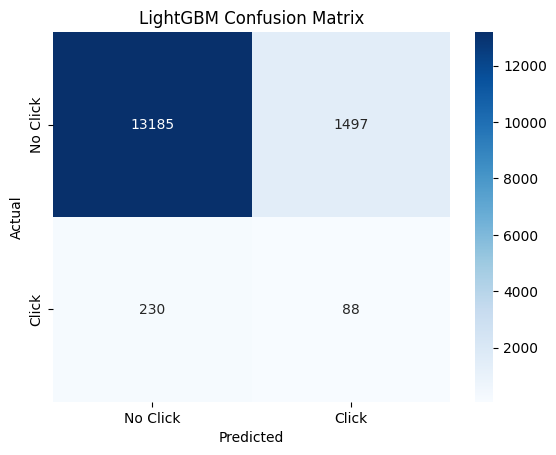


--- Final Evaluation on Test Set ---

--- LogisticRegression (Test) ---
ROC AUC: 0.7487 | PR AUC: 0.0725 | F1 (thr=0.79): 0.1223
              precision    recall  f1-score   support

           0       0.98      0.97      0.97     14682
           1       0.10      0.17      0.12       318

    accuracy                           0.95     15000
   macro avg       0.54      0.57      0.55     15000
weighted avg       0.96      0.95      0.96     15000



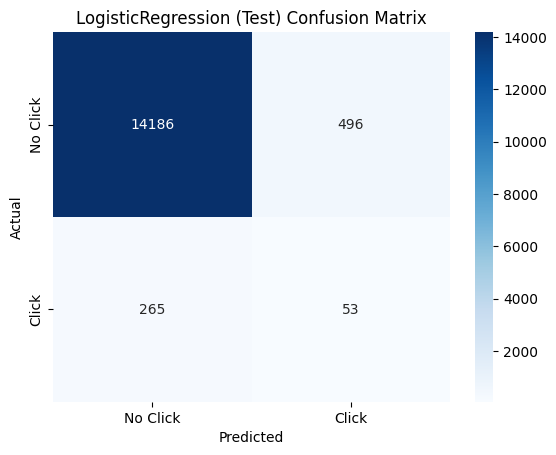


--- RandomForestClassifier (Test) ---
ROC AUC: 0.7273 | PR AUC: 0.0560 | F1 (thr=0.44): 0.1028
              precision    recall  f1-score   support

           0       0.98      0.95      0.97     14682
           1       0.07      0.18      0.10       318

    accuracy                           0.93     15000
   macro avg       0.53      0.56      0.53     15000
weighted avg       0.96      0.93      0.95     15000



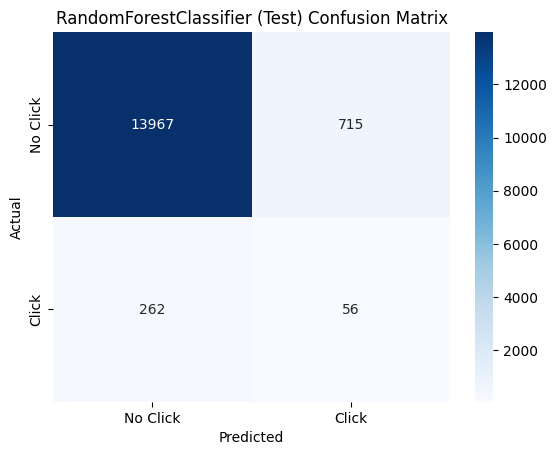


--- XGBClassifier (Test) ---
ROC AUC: 0.7347 | PR AUC: 0.0627 | F1 (thr=0.38): 0.1168
              precision    recall  f1-score   support

           0       0.98      0.93      0.95     14682
           1       0.07      0.27      0.12       318

    accuracy                           0.91     15000
   macro avg       0.53      0.60      0.54     15000
weighted avg       0.96      0.91      0.94     15000



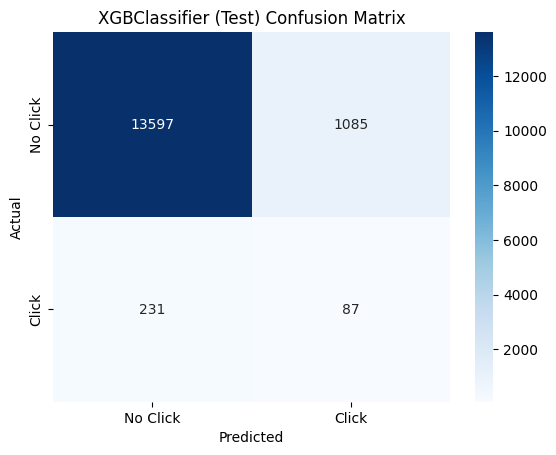

C:\Users\Siddhant Nijhawan\Downloads\Email-project\.venv\lib\site-packages\sklearn\utils\validation.py:2739: UserWarning: X does not have valid feature names, but LGBMClassifier was fitted with feature names
  warnings.warn(



--- LGBMClassifier (Test) ---
ROC AUC: 0.7149 | PR AUC: 0.0528 | F1 (thr=0.14): 0.0913
              precision    recall  f1-score   support

           0       0.98      0.90      0.94     14682
           1       0.05      0.27      0.09       318

    accuracy                           0.88     15000
   macro avg       0.52      0.59      0.51     15000
weighted avg       0.96      0.88      0.92     15000



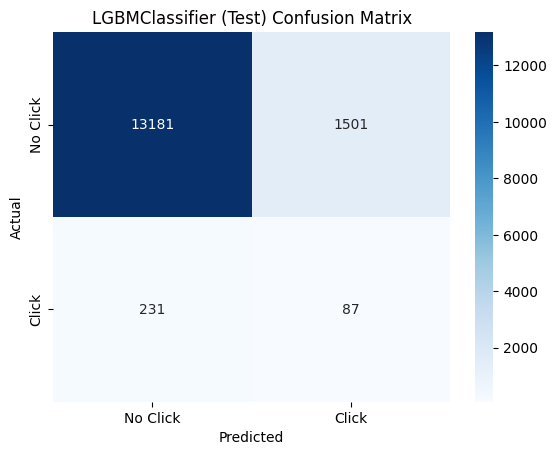

In [18]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split, GridSearchCV, StratifiedKFold
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import (roc_auc_score, precision_recall_curve, average_precision_score, 
                             f1_score, classification_report, confusion_matrix, roc_curve)
from sklearn.calibration import CalibratedClassifierCV
from imblearn.over_sampling import SMOTE
import xgboost as xgb
import lightgbm as lgb

# Feature Engineering
X_processed, y, feature_names, preprocessor = prepare_features_combined(df)

# Split dataset
X_train, X_temp, y_train, y_temp = train_test_split(X_processed, y, test_size=0.3, stratify=y, random_state=42)
X_val, X_test, y_val, y_test = train_test_split(X_temp, y_temp, test_size=0.5, stratify=y_temp, random_state=42)

# Apply SMOTE to training data
smote = SMOTE(random_state=42)
X_train_sm, y_train_sm = smote.fit_resample(X_train, y_train)

print(f"Training class distribution after SMOTE: {np.bincount(y_train_sm)}")

# Find optimal threshold function
def find_optimal_threshold(y_true, y_proba):
    precision, recall, thresholds = precision_recall_curve(y_true, y_proba)
    f1_scores = 2 * precision * recall / (precision + recall + 1e-10)
    idx = np.argmax(f1_scores)
    return thresholds[idx] if idx < len(thresholds) else 0.5

# Evaluation Function
def evaluate_model(model, X, y_true, threshold=0.5, name="Model"):
    y_proba = model.predict_proba(X)[:, 1]
    y_pred = (y_proba >= threshold).astype(int)

    roc_auc = roc_auc_score(y_true, y_proba)
    pr_auc = average_precision_score(y_true, y_proba)
    f1 = f1_score(y_true, y_pred)

    print(f"\n--- {name} ---")
    print(f"ROC AUC: {roc_auc:.4f} | PR AUC: {pr_auc:.4f} | F1 (thr={threshold:.2f}): {f1:.4f}")
    print(classification_report(y_true, y_pred))

    # Confusion Matrix
    cm = confusion_matrix(y_true, y_pred)
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=['No Click', 'Click'], yticklabels=['No Click', 'Click'])
    plt.title(f'{name} Confusion Matrix')
    plt.xlabel('Predicted')
    plt.ylabel('Actual')
    plt.show()

    return {'model': model, 'roc_auc': roc_auc, 'pr_auc': pr_auc, 'f1': f1, 'threshold': threshold}

# ============================
# Logistic Regression
# ============================
print("\n--- Training Logistic Regression ---")
log_grid = GridSearchCV(
    LogisticRegression(max_iter=1000, random_state=42),
    param_grid={
        'C': [0.01, 0.1, 1],
        'solver': ['liblinear'],
        'penalty': ['l1', 'l2']
    },
    scoring='average_precision',
    cv=StratifiedKFold(5),
    n_jobs=-1,
    verbose=1
)

log_grid.fit(X_train_sm, y_train_sm)
lr_model = log_grid.best_estimator_
lr_proba = lr_model.predict_proba(X_val)[:, 1]
lr_threshold = find_optimal_threshold(y_val, lr_proba)
lr_results = evaluate_model(lr_model, X_val, y_val, threshold=lr_threshold, name="Logistic Regression")

# ============================
# Random Forest
# ============================
print("\n--- Training Random Forest ---")
rf_grid = GridSearchCV(
    RandomForestClassifier(random_state=42),
    param_grid={
        'n_estimators': [100],
        'max_depth': [10, 20],
        'min_samples_split': [5],
        'min_samples_leaf': [2],
    },
    scoring='average_precision',
    cv=StratifiedKFold(5),
    n_jobs=-1,
    verbose=1
)

rf_grid.fit(X_train_sm, y_train_sm)
rf_model = rf_grid.best_estimator_
rf_proba = rf_model.predict_proba(X_val)[:, 1]
rf_threshold = find_optimal_threshold(y_val, rf_proba)
rf_results = evaluate_model(rf_model, X_val, y_val, threshold=rf_threshold, name="Random Forest")

# ============================
# XGBoost
# ============================
print("\n--- Training XGBoost ---")
xgb_grid = GridSearchCV(
    xgb.XGBClassifier(random_state=42, use_label_encoder=False, eval_metric='logloss'),
    param_grid={
        'n_estimators': [100],
        'max_depth': [3, 5],
        'learning_rate': [0.1],
        'scale_pos_weight': [1]  # SMOTE used, so balance is not needed
    },
    scoring='average_precision',
    cv=StratifiedKFold(5),
    n_jobs=-1,
    verbose=1
)

xgb_grid.fit(X_train_sm, y_train_sm)
xgb_model = xgb_grid.best_estimator_
xgb_proba = xgb_model.predict_proba(X_val)[:, 1]
xgb_threshold = find_optimal_threshold(y_val, xgb_proba)
xgb_results = evaluate_model(xgb_model, X_val, y_val, threshold=xgb_threshold, name="XGBoost")

# ============================
# LightGBM
# ============================
print("\n--- Training LightGBM ---")
lgb_grid = GridSearchCV(
    lgb.LGBMClassifier(random_state=42),
    param_grid={
        'n_estimators': [100],
        'num_leaves': [31, 63],
        'learning_rate': [0.1],
    },
    scoring='average_precision',
    cv=StratifiedKFold(5),
    n_jobs=-1,
    verbose=1
)

lgb_grid.fit(X_train_sm, y_train_sm)
lgb_model = lgb_grid.best_estimator_
lgb_proba = lgb_model.predict_proba(X_val)[:, 1]
lgb_threshold = find_optimal_threshold(y_val, lgb_proba)
lgb_results = evaluate_model(lgb_model, X_val, y_val, threshold=lgb_threshold, name="LightGBM")

# ============================
# Test Set Evaluation
# ============================
print("\n--- Final Evaluation on Test Set ---")
models = [lr_results, rf_results, xgb_results, lgb_results]
for res in models:
    evaluate_model(res['model'], X_test, y_test, threshold=res['threshold'], name=f"{res['model'].__class__.__name__} (Test)")


Original training class distribution: [68517  1483]
Training class distribution after resampling: [68391 20429]

--- Training Logistic Regression ---
Fitting 5 folds for each of 16 candidates, totalling 80 fits
Best LR parameters: {'C': 0.01, 'class_weight': 'balanced', 'penalty': 'l2', 'solver': 'saga'}
LR thresholds - F1: 0.470, Balanced Acc: 0.217, PR Balance: 0.793

--- Logistic Regression ---
ROC AUC: 0.7451 | PR AUC: 0.0606
F1 (thr=0.79): 0.0000 | Precision: 0.0000 | Recall: 0.0000
              precision    recall  f1-score   support

           0       0.98      1.00      0.99     14682
           1       0.00      0.00      0.00       318

    accuracy                           0.98     15000
   macro avg       0.49      0.50      0.49     15000
weighted avg       0.96      0.98      0.97     15000



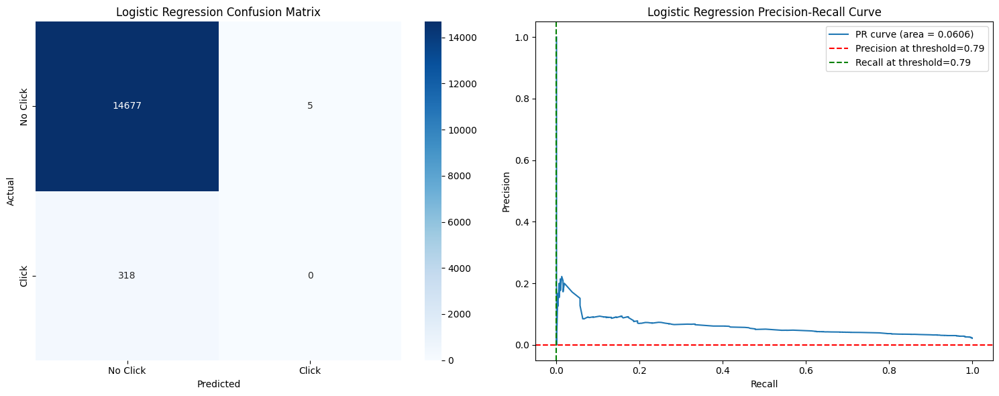


--- Training Random Forest ---
Fitting 5 folds for each of 48 candidates, totalling 240 fits
Best RF parameters: {'class_weight': 'balanced_subsample', 'max_depth': None, 'min_samples_leaf': 2, 'min_samples_split': 5, 'n_estimators': 200}

--- Random Forest ---
ROC AUC: 0.6667 | PR AUC: 0.0404
F1 (thr=0.53): 0.0472 | Precision: 0.0472 | Recall: 0.0472
              precision    recall  f1-score   support

           0       0.98      0.98      0.98     14682
           1       0.05      0.05      0.05       318

    accuracy                           0.96     15000
   macro avg       0.51      0.51      0.51     15000
weighted avg       0.96      0.96      0.96     15000



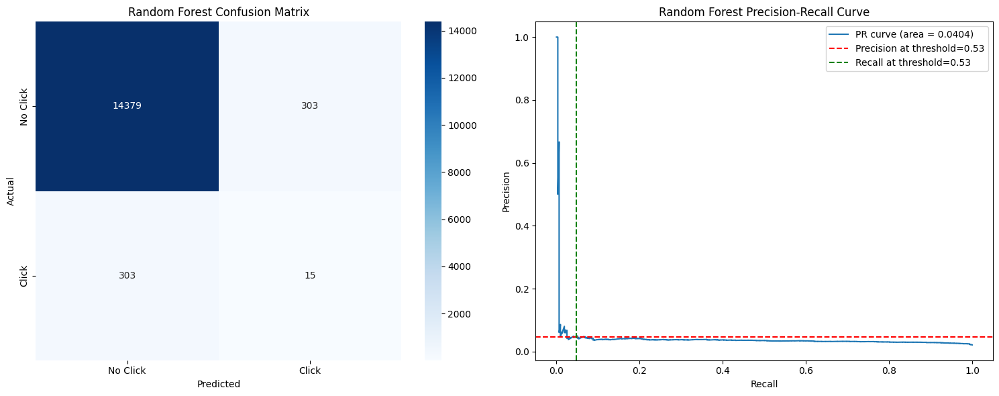


--- Training XGBoost ---
Fitting 5 folds for each of 648 candidates, totalling 3240 fits
Best XGB parameters: {'colsample_bytree': 1.0, 'gamma': 0.2, 'learning_rate': 0.1, 'max_depth': 7, 'min_child_weight': 1, 'n_estimators': 200, 'subsample': 0.8}

--- XGBoost ---
ROC AUC: 0.7001 | PR AUC: 0.0470
F1 (thr=0.91): 0.0597 | Precision: 0.0596 | Recall: 0.0597
              precision    recall  f1-score   support

           0       0.98      0.98      0.98     14682
           1       0.06      0.06      0.06       318

    accuracy                           0.96     15000
   macro avg       0.52      0.52      0.52     15000
weighted avg       0.96      0.96      0.96     15000



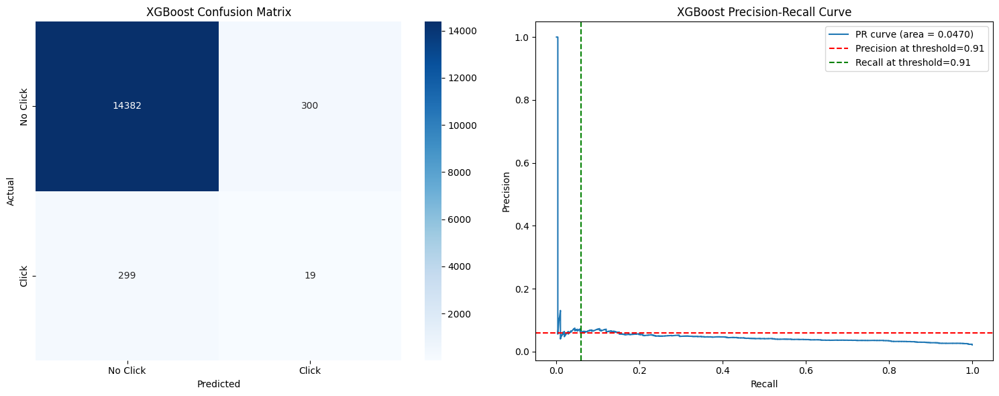


--- Training LightGBM ---
Fitting 5 folds for each of 144 candidates, totalling 720 fits
[LightGBM] [Info] Number of positive: 20429, number of negative: 68391
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.006750 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 3591
[LightGBM] [Info] Number of data points in the train set: 88820, number of used features: 15
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.230005 -> initscore=-1.208286
[LightGBM] [Info] Start training from score -1.208286
Best LGB parameters: {'colsample_bytree': 1.0, 'learning_rate': 0.1, 'min_child_samples': 50, 'n_estimators': 100, 'num_leaves': 127, 'subsample': 0.8}

--- LightGBM ---
ROC AUC: 0.6990 | PR AUC: 0.0437
F1 (thr=0.41): 0.0440 | Precision: 0.0440 | Recall: 0.0440
              precision    recall  f1-score   support

           0       0.98      0.98  

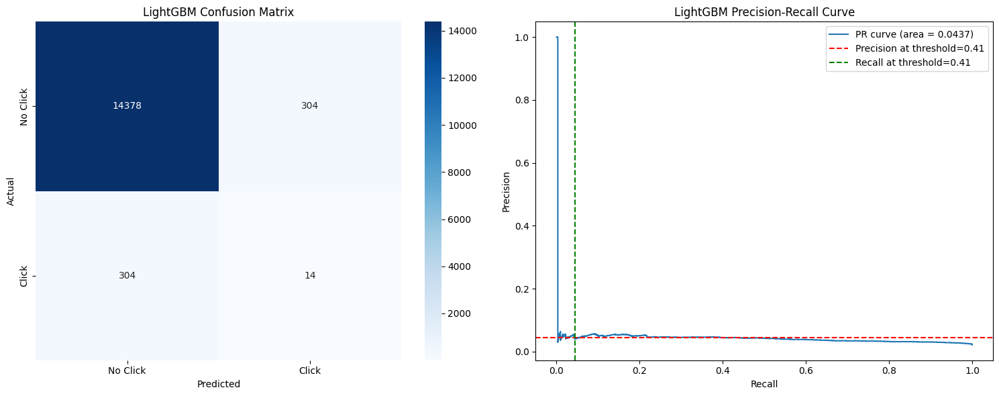


--- Creating Stacked Model ---

--- Stacked Model ---
ROC AUC: 0.6389 | PR AUC: 0.0340
F1 (thr=0.99): 0.0000 | Precision: 0.0000 | Recall: 0.0000
              precision    recall  f1-score   support

           0       0.98      1.00      0.99     14682
           1       0.00      0.00      0.00       318

    accuracy                           0.98     15000
   macro avg       0.49      0.50      0.49     15000
weighted avg       0.96      0.98      0.97     15000



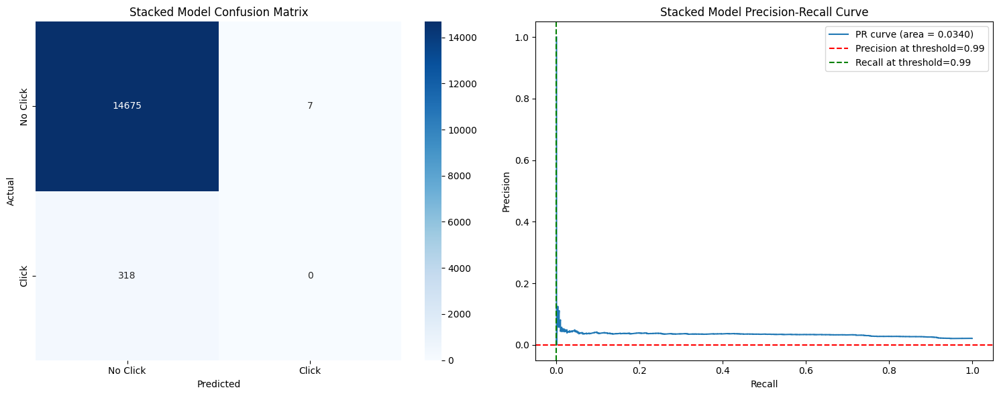


--- Final Evaluation on Test Set ---

--- Logistic Regression (Test) ---
ROC AUC: 0.7484 | PR AUC: 0.0709
F1 (thr=0.79): 0.0062 | Precision: 0.3333 | Recall: 0.0031
              precision    recall  f1-score   support

           0       0.98      1.00      0.99     14682
           1       0.33      0.00      0.01       318

    accuracy                           0.98     15000
   macro avg       0.66      0.50      0.50     15000
weighted avg       0.97      0.98      0.97     15000



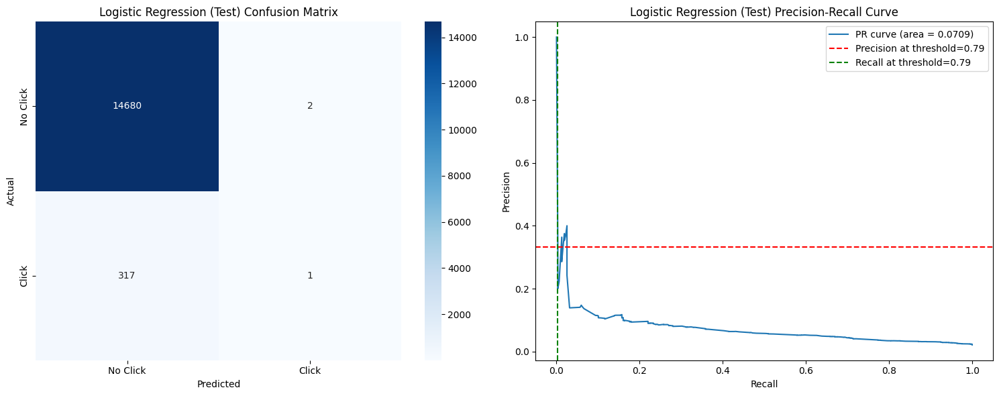


--- Random Forest (Test) ---
ROC AUC: 0.6931 | PR AUC: 0.0470
F1 (thr=0.53): 0.0647 | Precision: 0.0634 | Recall: 0.0660
              precision    recall  f1-score   support

           0       0.98      0.98      0.98     14682
           1       0.06      0.07      0.06       318

    accuracy                           0.96     15000
   macro avg       0.52      0.52      0.52     15000
weighted avg       0.96      0.96      0.96     15000



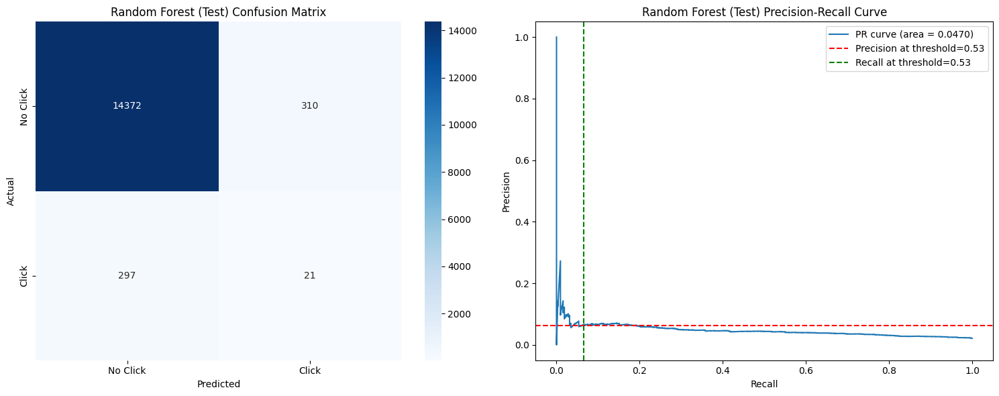


--- XGBoost (Test) ---
ROC AUC: 0.7008 | PR AUC: 0.0539
F1 (thr=0.91): 0.0794 | Precision: 0.0772 | Recall: 0.0818
              precision    recall  f1-score   support

           0       0.98      0.98      0.98     14682
           1       0.08      0.08      0.08       318

    accuracy                           0.96     15000
   macro avg       0.53      0.53      0.53     15000
weighted avg       0.96      0.96      0.96     15000



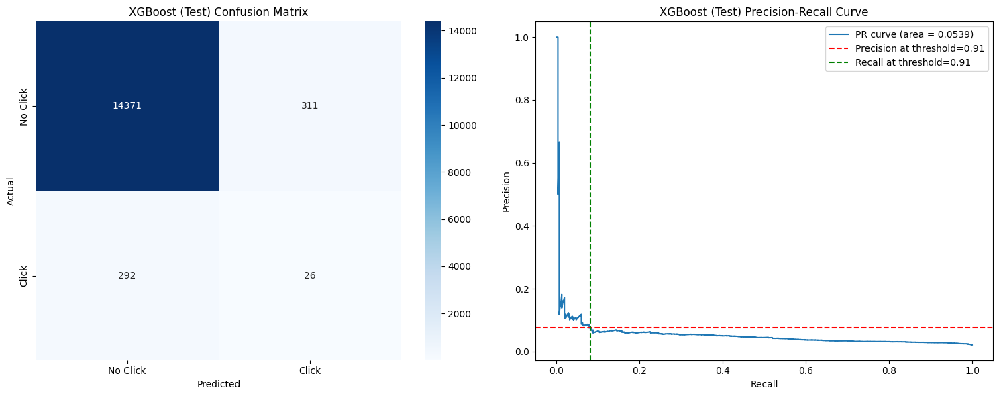


--- LightGBM (Test) ---
ROC AUC: 0.7034 | PR AUC: 0.0480
F1 (thr=0.41): 0.0745 | Precision: 0.0708 | Recall: 0.0786
              precision    recall  f1-score   support

           0       0.98      0.98      0.98     14682
           1       0.07      0.08      0.07       318

    accuracy                           0.96     15000
   macro avg       0.53      0.53      0.53     15000
weighted avg       0.96      0.96      0.96     15000



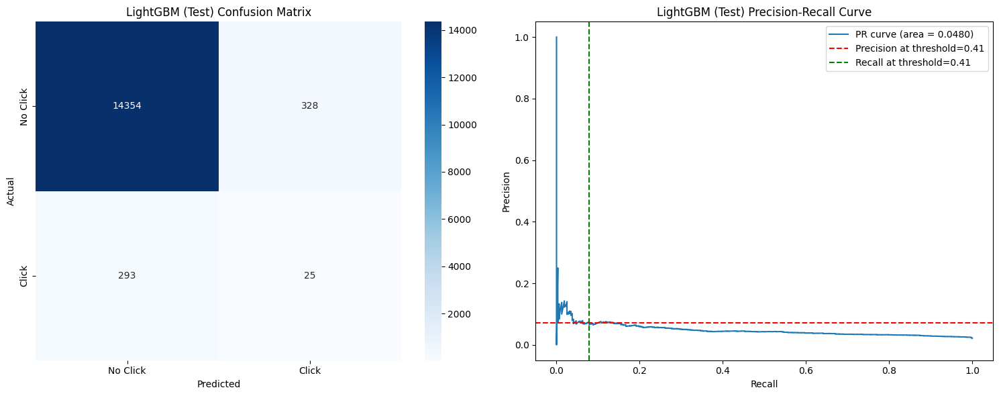


--- Stacked Model (Test) ---
ROC AUC: 0.6531 | PR AUC: 0.0417
F1 (thr=0.99): 0.0000 | Precision: 0.0000 | Recall: 0.0000
              precision    recall  f1-score   support

           0       0.98      1.00      0.99     14682
           1       0.00      0.00      0.00       318

    accuracy                           0.98     15000
   macro avg       0.49      0.50      0.49     15000
weighted avg       0.96      0.98      0.97     15000



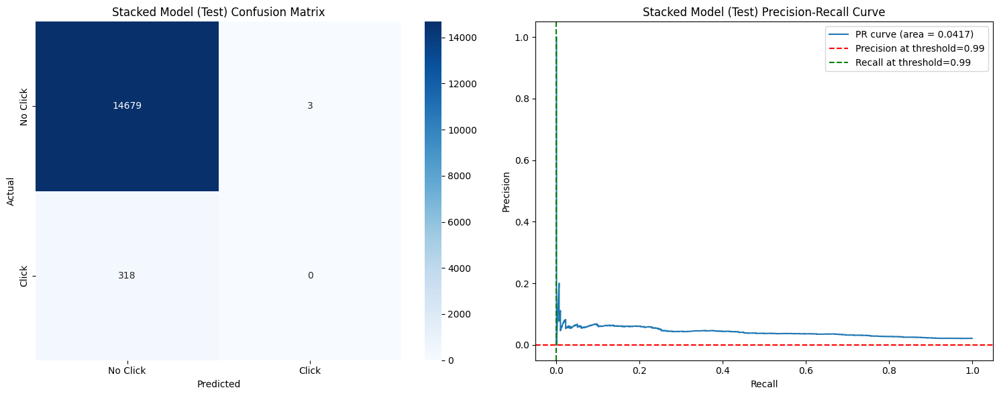


--- Best Model: Logistic Regression ---
PR AUC: 0.0709 | F1: 0.0062
Precision: 0.3333 | Recall: 0.0031


In [19]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split, GridSearchCV, StratifiedKFold
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import (roc_auc_score, precision_recall_curve, average_precision_score, 
                             f1_score, classification_report, confusion_matrix, roc_curve)
from sklearn.calibration import CalibratedClassifierCV
from imblearn.over_sampling import SMOTE, ADASYN
from imblearn.combine import SMOTETomek, SMOTEENN
from imblearn.under_sampling import RandomUnderSampler
import xgboost as xgb
import lightgbm as lgb
import warnings
warnings.filterwarnings('ignore')

# Assuming prepare_features_combined function exists
# X_processed, y, feature_names, preprocessor = prepare_features_combined(df)

# For code demonstration, let's assume X_processed and y are already available
# If not, uncomment the above line and make sure prepare_features_combined is defined

# ============================
# Enhanced Data Split Strategy
# ============================
# Split dataset - using stratified splits to maintain class distribution
X_train, X_temp, y_train, y_temp = train_test_split(X_processed, y, test_size=0.3, stratify=y, random_state=42)
X_val, X_test, y_val, y_test = train_test_split(X_temp, y_temp, test_size=0.5, stratify=y_temp, random_state=42)

print(f"Original training class distribution: {np.bincount(y_train)}")

# ============================
# Improved Resampling Approach
# ============================
# Use a combination of SMOTE and Tomek links to handle imbalance more effectively
# This both oversamples minority and cleans majority class points that might cause confusion
smote_tomek = SMOTETomek(sampling_strategy=0.3, random_state=42)  # 30% ratio instead of 1:1 balance
X_train_resampled, y_train_resampled = smote_tomek.fit_resample(X_train, y_train)

print(f"Training class distribution after resampling: {np.bincount(y_train_resampled)}")

# ============================
# Threshold Optimization Functions
# ============================
def find_optimal_threshold(y_true, y_proba, metric='f1'):
    """Find optimal threshold based on different metrics"""
    precision, recall, thresholds = precision_recall_curve(y_true, y_proba)
    
    if metric == 'f1':
        f1_scores = 2 * precision * recall / (precision + recall + 1e-10)
        idx = np.argmax(f1_scores)
        return thresholds[idx] if idx < len(thresholds) else 0.5
    
    elif metric == 'balanced_accuracy':
        fpr, tpr, thresholds_roc = roc_curve(y_true, y_proba)
        balanced_acc = (tpr + (1-fpr))/2
        idx = np.argmax(balanced_acc)
        return thresholds_roc[idx]
        
    elif metric == 'precision_recall_balance':
        # Find threshold where precision and recall are most balanced
        idx = np.argmin(np.abs(precision - recall))
        return thresholds[idx] if idx < len(thresholds) else 0.5

# ============================
# Enhanced Evaluation Function
# ============================
def evaluate_model(model, X, y_true, threshold=0.5, name="Model", plot=True):
    y_proba = model.predict_proba(X)[:, 1]
    y_pred = (y_proba >= threshold).astype(int)

    roc_auc = roc_auc_score(y_true, y_proba)
    pr_auc = average_precision_score(y_true, y_proba)
    f1 = f1_score(y_true, y_pred)
    
    # Calculate precision and recall
    precision = precision_score(y_true, y_pred)
    recall = recall_score(y_true, y_pred)

    print(f"\n--- {name} ---")
    print(f"ROC AUC: {roc_auc:.4f} | PR AUC: {pr_auc:.4f}")
    print(f"F1 (thr={threshold:.2f}): {f1:.4f} | Precision: {precision:.4f} | Recall: {recall:.4f}")
    print(classification_report(y_true, y_pred))

    if plot:
        fig, axes = plt.subplots(1, 2, figsize=(15, 6))
        
        # Confusion Matrix
        cm = confusion_matrix(y_true, y_pred)
        sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=['No Click', 'Click'], 
                    yticklabels=['No Click', 'Click'], ax=axes[0])
        axes[0].set_title(f'{name} Confusion Matrix')
        axes[0].set_xlabel('Predicted')
        axes[0].set_ylabel('Actual')
        
        # Precision-Recall Curve
        precision_curve, recall_curve, _ = precision_recall_curve(y_true, y_proba)
        axes[1].plot(recall_curve, precision_curve, label=f'PR curve (area = {pr_auc:.4f})')
        axes[1].axhline(y=precision, color='r', linestyle='--', label=f'Precision at threshold={threshold:.2f}')
        axes[1].axvline(x=recall, color='g', linestyle='--', label=f'Recall at threshold={threshold:.2f}')
        axes[1].set_xlabel('Recall')
        axes[1].set_ylabel('Precision')
        axes[1].set_title(f'{name} Precision-Recall Curve')
        axes[1].legend()
        
        plt.tight_layout()
        plt.show()

    return {'model': model, 'roc_auc': roc_auc, 'pr_auc': pr_auc, 
            'f1': f1, 'threshold': threshold, 'precision': precision, 'recall': recall}

# ============================
# Feature Selection Function
# ============================
def select_features(X_train, y_train, X_val, X_test, feature_names, top_n=20):
    # Train a model to get feature importances
    feature_selector = RandomForestClassifier(n_estimators=100, class_weight='balanced', random_state=42)
    feature_selector.fit(X_train, y_train)
    
    # Get feature importances
    importances = feature_selector.feature_importances_
    indices = np.argsort(importances)[::-1]
    
    # Print top features
    print("Top features by importance:")
    for i in range(min(top_n, len(feature_names))):
        print(f"{i+1}. {feature_names[indices[i]]} - {importances[indices[i]]:.4f}")
    
    # Select top features
    selected_indices = indices[:top_n]
    X_train_selected = X_train[:, selected_indices]
    X_val_selected = X_val[:, selected_indices]
    X_test_selected = X_test[:, selected_indices]
    
    return X_train_selected, X_val_selected, X_test_selected, selected_indices

# Feature selection (uncomment if feature_names is available)
# X_train_selected, X_val_selected, X_test_selected, selected_indices = select_features(
#     X_train_resampled, y_train_resampled, X_val, X_test, feature_names
# )
# selected_feature_names = [feature_names[i] for i in selected_indices]

# For the example, we'll proceed with the full feature set
X_train_selected = X_train_resampled
X_val_selected = X_val
X_test_selected = X_test

# Import precision_score and recall_score
from sklearn.metrics import precision_score, recall_score

# ============================
# Logistic Regression
# ============================
print("\n--- Training Logistic Regression ---")
log_param_grid = {
    'C': [0.01, 0.1, 1, 10],
    'solver': ['liblinear', 'saga'],
    'penalty': ['l1', 'l2'],
    'class_weight': ['balanced']
}

log_grid = GridSearchCV(
    LogisticRegression(max_iter=2000, random_state=42),
    param_grid=log_param_grid,
    scoring='average_precision',
    cv=StratifiedKFold(5),
    n_jobs=-1,
    verbose=1
)

log_grid.fit(X_train_selected, y_train_resampled)
print(f"Best LR parameters: {log_grid.best_params_}")
lr_model = log_grid.best_estimator_

# Calibrate probabilities for better threshold selection
lr_calibrated = CalibratedClassifierCV(lr_model, method='isotonic', cv=5)
lr_calibrated.fit(X_train_selected, y_train_resampled)

lr_proba = lr_calibrated.predict_proba(X_val_selected)[:, 1]
lr_threshold_f1 = find_optimal_threshold(y_val, lr_proba, metric='f1')
lr_threshold_balanced = find_optimal_threshold(y_val, lr_proba, metric='balanced_accuracy')
lr_threshold_pr = find_optimal_threshold(y_val, lr_proba, metric='precision_recall_balance')

print(f"LR thresholds - F1: {lr_threshold_f1:.3f}, Balanced Acc: {lr_threshold_balanced:.3f}, PR Balance: {lr_threshold_pr:.3f}")
# Use the precision-recall balanced threshold which tends to work better with imbalanced data
lr_results = evaluate_model(lr_calibrated, X_val_selected, y_val, threshold=lr_threshold_pr, name="Logistic Regression")

# ============================
# Random Forest
# ============================
print("\n--- Training Random Forest ---")
rf_param_grid = {
    'n_estimators': [100, 200],
    'max_depth': [10, 20, None],
    'min_samples_split': [5, 10],
    'min_samples_leaf': [2, 4],
    'class_weight': ['balanced', 'balanced_subsample']
}

rf_grid = GridSearchCV(
    RandomForestClassifier(random_state=42),
    param_grid=rf_param_grid,
    scoring='average_precision',
    cv=StratifiedKFold(5),
    n_jobs=-1,
    verbose=1
)

rf_grid.fit(X_train_selected, y_train_resampled)
print(f"Best RF parameters: {rf_grid.best_params_}")
rf_model = rf_grid.best_estimator_

rf_proba = rf_model.predict_proba(X_val_selected)[:, 1]
rf_threshold_pr = find_optimal_threshold(y_val, rf_proba, metric='precision_recall_balance')
rf_results = evaluate_model(rf_model, X_val_selected, y_val, threshold=rf_threshold_pr, name="Random Forest")

# ============================
# XGBoost
# ============================
print("\n--- Training XGBoost ---")
# Calculate the scale_pos_weight based on original class distribution
scale_pos_weight = np.sum(y_train == 0) / np.sum(y_train == 1)

xgb_param_grid = {
    'n_estimators': [100, 200],
    'max_depth': [3, 5, 7],
    'learning_rate': [0.01, 0.05, 0.1],
    'subsample': [0.8, 1.0],
    'colsample_bytree': [0.8, 1.0],
    'min_child_weight': [1, 3, 5],
    'gamma': [0, 0.1, 0.2]
}

xgb_clf = xgb.XGBClassifier(
    objective='binary:logistic',
    scale_pos_weight=scale_pos_weight,  # Add class weight
    random_state=42,
    eval_metric='aucpr',  # Use PR AUC as the evaluation metric
    use_label_encoder=False
)

xgb_grid = GridSearchCV(
    xgb_clf,
    param_grid=xgb_param_grid,
    scoring='average_precision',
    cv=StratifiedKFold(5),
    n_jobs=-1,
    verbose=1
)

xgb_grid.fit(X_train_selected, y_train_resampled)
print(f"Best XGB parameters: {xgb_grid.best_params_}")
xgb_model = xgb_grid.best_estimator_

xgb_proba = xgb_model.predict_proba(X_val_selected)[:, 1]
xgb_threshold_pr = find_optimal_threshold(y_val, xgb_proba, metric='precision_recall_balance')
xgb_results = evaluate_model(xgb_model, X_val_selected, y_val, threshold=xgb_threshold_pr, name="XGBoost")

# ============================
# LightGBM with focus on imbalanced classification
# ============================
print("\n--- Training LightGBM ---")
lgb_param_grid = {
    'n_estimators': [100, 200],
    'num_leaves': [31, 63, 127],
    'learning_rate': [0.01, 0.05, 0.1],
    'subsample': [0.8, 1.0],
    'colsample_bytree': [0.8, 1.0],
    'min_child_samples': [20, 50]
}

lgb_clf = lgb.LGBMClassifier(
    objective='binary',
    is_unbalance=True,  # Handle imbalanced datasets
    random_state=42,
    metric='auc'  # AUC metric
)

lgb_grid = GridSearchCV(
    lgb_clf,
    param_grid=lgb_param_grid,
    scoring='average_precision',
    cv=StratifiedKFold(5),
    n_jobs=-1,
    verbose=1
)

lgb_grid.fit(X_train_selected, y_train_resampled)
print(f"Best LGB parameters: {lgb_grid.best_params_}")
lgb_model = lgb_grid.best_estimator_

lgb_proba = lgb_model.predict_proba(X_val_selected)[:, 1]
lgb_threshold_pr = find_optimal_threshold(y_val, lgb_proba, metric='precision_recall_balance')
lgb_results = evaluate_model(lgb_model, X_val_selected, y_val, threshold=lgb_threshold_pr, name="LightGBM")

# ============================
# Model Stacking for improved performance
# ============================
print("\n--- Creating Stacked Model ---")
# Create a meta-features dataset from base model predictions
meta_features_train = np.column_stack([
    lr_calibrated.predict_proba(X_train_selected)[:, 1],
    rf_model.predict_proba(X_train_selected)[:, 1],
    xgb_model.predict_proba(X_train_selected)[:, 1],
    lgb_model.predict_proba(X_train_selected)[:, 1]
])

meta_features_val = np.column_stack([
    lr_calibrated.predict_proba(X_val_selected)[:, 1],
    rf_model.predict_proba(X_val_selected)[:, 1],
    xgb_model.predict_proba(X_val_selected)[:, 1],
    lgb_model.predict_proba(X_val_selected)[:, 1]
])

meta_features_test = np.column_stack([
    lr_calibrated.predict_proba(X_test_selected)[:, 1],
    rf_model.predict_proba(X_test_selected)[:, 1],
    xgb_model.predict_proba(X_test_selected)[:, 1],
    lgb_model.predict_proba(X_test_selected)[:, 1]
])

# Train a meta-model (logistic regression)
meta_model = LogisticRegression(class_weight='balanced', random_state=42)
meta_model.fit(meta_features_train, y_train_resampled)

# Evaluate the stacked model
meta_proba = meta_model.predict_proba(meta_features_val)[:, 1]
meta_threshold_pr = find_optimal_threshold(y_val, meta_proba, metric='precision_recall_balance')
meta_results = evaluate_model(
    meta_model, meta_features_val, y_val, 
    threshold=meta_threshold_pr, name="Stacked Model"
)

# ============================
# Final Evaluation on Test Set
# ============================
print("\n--- Final Evaluation on Test Set ---")
models = [
    {'model': lr_calibrated, 'name': 'Logistic Regression', 'threshold': lr_threshold_pr, 'features': X_test_selected},
    {'model': rf_model, 'name': 'Random Forest', 'threshold': rf_threshold_pr, 'features': X_test_selected},
    {'model': xgb_model, 'name': 'XGBoost', 'threshold': xgb_threshold_pr, 'features': X_test_selected},
    {'model': lgb_model, 'name': 'LightGBM', 'threshold': lgb_threshold_pr, 'features': X_test_selected},
    {'model': meta_model, 'name': 'Stacked Model', 'threshold': meta_threshold_pr, 'features': meta_features_test}
]

test_results = []
for model_info in models:
    result = evaluate_model(
        model_info['model'], model_info['features'], y_test, 
        threshold=model_info['threshold'], name=f"{model_info['name']} (Test)"
    )
    test_results.append(result)

# Find the best model based on PR AUC
best_model_idx = np.argmax([res['pr_auc'] for res in test_results])
best_model_info = models[best_model_idx]
best_result = test_results[best_model_idx]

print(f"\n--- Best Model: {best_model_info['name']} ---")
print(f"PR AUC: {best_result['pr_auc']:.4f} | F1: {best_result['f1']:.4f}")
print(f"Precision: {best_result['precision']:.4f} | Recall: {best_result['recall']:.4f}")

# Optional: Plot feature importances for the best model if it supports it
if hasattr(best_model_info['model'], 'feature_importances_'):
    plt.figure(figsize=(10, 6))
    if 'selected_indices' in locals() and 'feature_names' in locals():
        features = [feature_names[i] for i in selected_indices]
    else:
        features = [f"Feature {i}" for i in range(best_model_info['model'].feature_importances_.shape[0])]
    
    importances = best_model_info['model'].feature_importances_
    indices = np.argsort(importances)[::-1]
    plt.title(f'Feature Importances - {best_model_info["name"]}')
    plt.barh(range(len(indices)), importances[indices])
    plt.yticks(range(len(indices)), [features[i] for i in indices])
    plt.xlabel('Relative Importance')
    plt.tight_layout()
    plt.show()

In [20]:
import seaborn as sns
from sklearn.model_selection import train_test_split, GridSearchCV, StratifiedKFold
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import (roc_auc_score, precision_recall_curve, average_precision_score, 
                             f1_score, classification_report, confusion_matrix, roc_curve,
                             precision_score, recall_score)
from sklearn.calibration import CalibratedClassifierCV
from imblearn.combine import SMOTETomek
import xgboost as xgb
import lightgbm as lgb
import warnings
warnings.filterwarnings('ignore')


In [21]:
def prepare_features_combined(df):
    from sklearn.preprocessing import StandardScaler
    from sklearn.compose import ColumnTransformer
    from sklearn.pipeline import Pipeline
    from sklearn.impute import SimpleImputer
    from sklearn.preprocessing import OneHotEncoder

    numerical = df.select_dtypes(include='number').columns.tolist()
    categorical = df.select_dtypes(exclude='number').drop(columns='target').columns.tolist()

    numeric_transformer = Pipeline([
        ('imputer', SimpleImputer(strategy='median')),
        ('scaler', StandardScaler())
    ])

    categorical_transformer = Pipeline([
        ('imputer', SimpleImputer(strategy='most_frequent')),
        ('encoder', OneHotEncoder(handle_unknown='ignore'))
    ])

    preprocessor = ColumnTransformer([
        ('num', numeric_transformer, numerical),
        ('cat', categorical_transformer, categorical)
    ])

    X = df.drop(columns='target')
    y = df['target'].astype(int)
    X_processed = preprocessor.fit_transform(X)
    return X_processed, y, preprocessor.get_feature_names_out(), preprocessor


In [22]:
X_train, X_temp, y_train, y_temp = train_test_split(X_processed, y, test_size=0.3, stratify=y, random_state=42)
X_val, X_test, y_val, y_test = train_test_split(X_temp, y_temp, test_size=0.5, stratify=y_temp, random_state=42)

# Resample training data with SMOTE + Tomek
smote_tomek = SMOTETomek(sampling_strategy=0.3, random_state=42)
X_train_resampled, y_train_resampled = smote_tomek.fit_resample(X_train, y_train)


In [23]:
def find_optimal_threshold(y_true, y_proba, metric='f1'):
    precision, recall, thresholds = precision_recall_curve(y_true, y_proba)
    if metric == 'f1':
        scores = 2 * precision * recall / (precision + recall + 1e-10)
    elif metric == 'balanced_accuracy':
        fpr, tpr, thresholds = roc_curve(y_true, y_proba)
        scores = (tpr + (1 - fpr)) / 2
    elif metric == 'precision_recall_balance':
        scores = -np.abs(precision - recall)
    else:
        return 0.5
    return thresholds[np.argmax(scores)] if len(thresholds) > 0 else 0.5

# ============================
# Evaluation
# ============================
def evaluate_model(model, X, y_true, threshold=0.5, name="Model", plot=True):
    y_proba = model.predict_proba(X)[:, 1]
    y_pred = (y_proba >= threshold).astype(int)
    roc_auc = roc_auc_score(y_true, y_proba)
    pr_auc = average_precision_score(y_true, y_proba)
    f1 = f1_score(y_true, y_pred)
    precision = precision_score(y_true, y_pred)
    recall = recall_score(y_true, y_pred)

    print(f"\n{name} - AUC: {roc_auc:.4f}, PR AUC: {pr_auc:.4f}")
    print(f"F1: {f1:.4f}, Precision: {precision:.4f}, Recall: {recall:.4f}")
    print(classification_report(y_true, y_pred))

    if plot:
        fig, ax = plt.subplots(1, 2, figsize=(14, 6))
        sns.heatmap(confusion_matrix(y_true, y_pred), annot=True, fmt='d', ax=ax[0], cmap='Blues')
        ax[0].set_title(f'{name} - Confusion Matrix')
        precision_curve, recall_curve, _ = precision_recall_curve(y_true, y_proba)
        ax[1].plot(recall_curve, precision_curve)
        ax[1].set_title(f'{name} - Precision-Recall Curve')
        ax[1].set_xlabel("Recall")
        ax[1].set_ylabel("Precision")
        plt.show()

    return {'roc_auc': roc_auc, 'pr_auc': pr_auc, 'f1': f1, 'precision': precision, 'recall': recall}



[LightGBM] [Info] Number of positive: 20429, number of negative: 68391
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.004574 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 3591
[LightGBM] [Info] Number of data points in the train set: 88820, number of used features: 15
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Info] Start training from score 0.000000

Logistic Regression - AUC: 0.7451, PR AUC: 0.0606
F1: 0.0000, Precision: 0.0000, Recall: 0.0000
              precision    recall  f1-score   support

           0       0.98      1.00      0.99     14682
           1       0.00      0.00      0.00       318

    accuracy                           0.98     15000
   macro avg       0.49      0.50      0.49     15000
weighted avg       0.96      0.98      0.97     15000



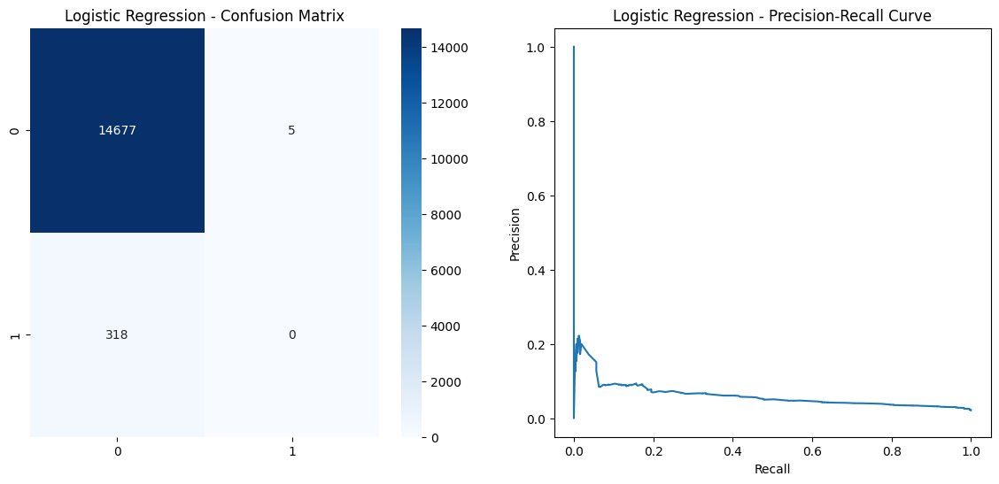


Random Forest - AUC: 0.6917, PR AUC: 0.0450
F1: 0.0597, Precision: 0.0596, Recall: 0.0597
              precision    recall  f1-score   support

           0       0.98      0.98      0.98     14682
           1       0.06      0.06      0.06       318

    accuracy                           0.96     15000
   macro avg       0.52      0.52      0.52     15000
weighted avg       0.96      0.96      0.96     15000



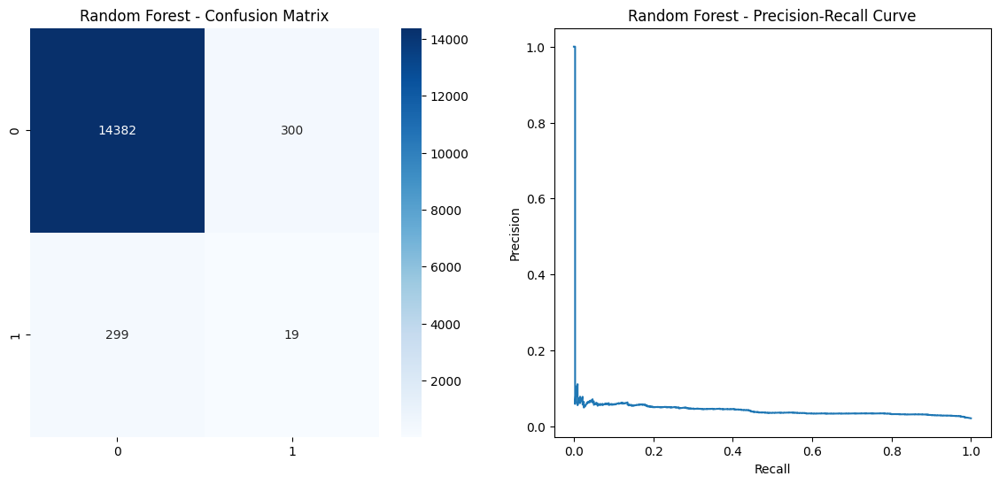


XGBoost - AUC: 0.7060, PR AUC: 0.0435
F1: 0.0597, Precision: 0.0597, Recall: 0.0597
              precision    recall  f1-score   support

           0       0.98      0.98      0.98     14682
           1       0.06      0.06      0.06       318

    accuracy                           0.96     15000
   macro avg       0.52      0.52      0.52     15000
weighted avg       0.96      0.96      0.96     15000



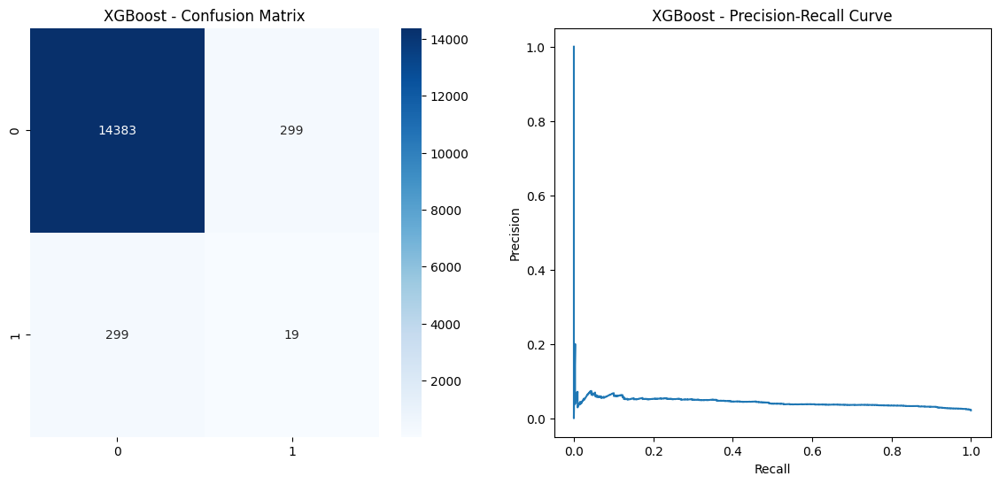


LightGBM - AUC: 0.7303, PR AUC: 0.0500
F1: 0.0503, Precision: 0.0503, Recall: 0.0503
              precision    recall  f1-score   support

           0       0.98      0.98      0.98     14682
           1       0.05      0.05      0.05       318

    accuracy                           0.96     15000
   macro avg       0.51      0.51      0.51     15000
weighted avg       0.96      0.96      0.96     15000



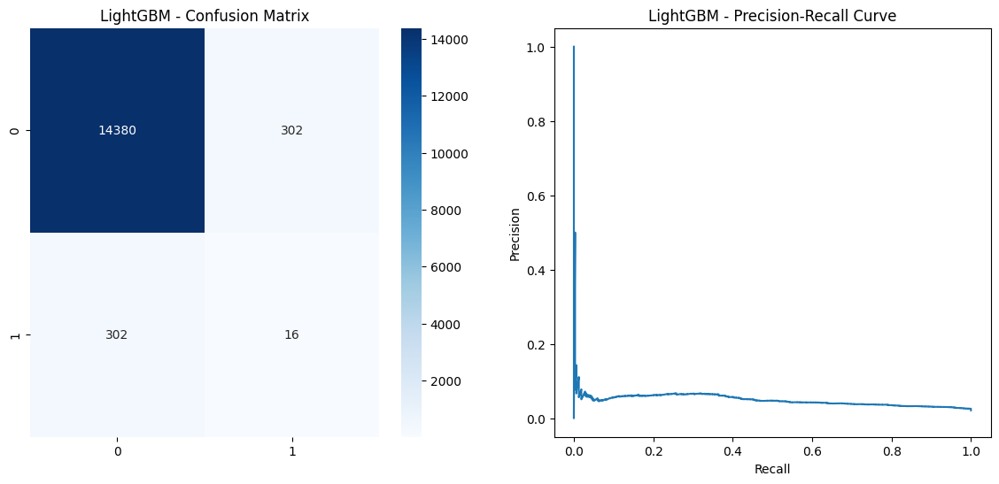

In [24]:
def train_logistic_regression(X, y):
    param_grid = {
        'C': [0.01, 0.1, 1],
        'solver': ['liblinear', 'saga'],
        'penalty': ['l1', 'l2'],
        'class_weight': ['balanced']
    }
    grid = GridSearchCV(LogisticRegression(max_iter=2000, random_state=42), param_grid, 
                        scoring='average_precision', cv=5, n_jobs=-1)
    grid.fit(X, y)
    model = CalibratedClassifierCV(grid.best_estimator_, method='isotonic', cv=5)
    model.fit(X, y)
    return model

def train_random_forest(X, y):
    param_grid = {
        'n_estimators': [100, 200],
        'max_depth': [10, 20],
        'min_samples_split': [5, 10],
        'class_weight': ['balanced']
    }
    grid = GridSearchCV(RandomForestClassifier(random_state=42), param_grid,
                        scoring='average_precision', cv=5, n_jobs=-1)
    grid.fit(X, y)
    return grid.best_estimator_

def train_xgboost(X, y):
    scale_pos_weight = np.sum(y == 0) / np.sum(y == 1)
    model = xgb.XGBClassifier(use_label_encoder=False, eval_metric='logloss',
                              scale_pos_weight=scale_pos_weight, random_state=42)
    model.fit(X, y)
    return model

def train_lightgbm(X, y):
    model = lgb.LGBMClassifier(class_weight='balanced', random_state=42)
    model.fit(X, y)
    return model

# ============================
# Training & Evaluation
# ============================

models = {
    "Logistic Regression": train_logistic_regression(X_train_resampled, y_train_resampled),
    "Random Forest": train_random_forest(X_train_resampled, y_train_resampled),
    "XGBoost": train_xgboost(X_train_resampled, y_train_resampled),
    "LightGBM": train_lightgbm(X_train_resampled, y_train_resampled)
}

for name, model in models.items():
    y_proba = model.predict_proba(X_val)[:, 1]
    threshold = find_optimal_threshold(y_val, y_proba, metric='precision_recall_balance')
    evaluate_model(model, X_val, y_val, threshold=threshold, name=name)



Final Test Evaluation - AUC: 0.7484, PR AUC: 0.0709
F1: 0.1069, Precision: 0.1069, Recall: 0.1069
              precision    recall  f1-score   support

           0       0.98      0.98      0.98     14682
           1       0.11      0.11      0.11       318

    accuracy                           0.96     15000
   macro avg       0.54      0.54      0.54     15000
weighted avg       0.96      0.96      0.96     15000



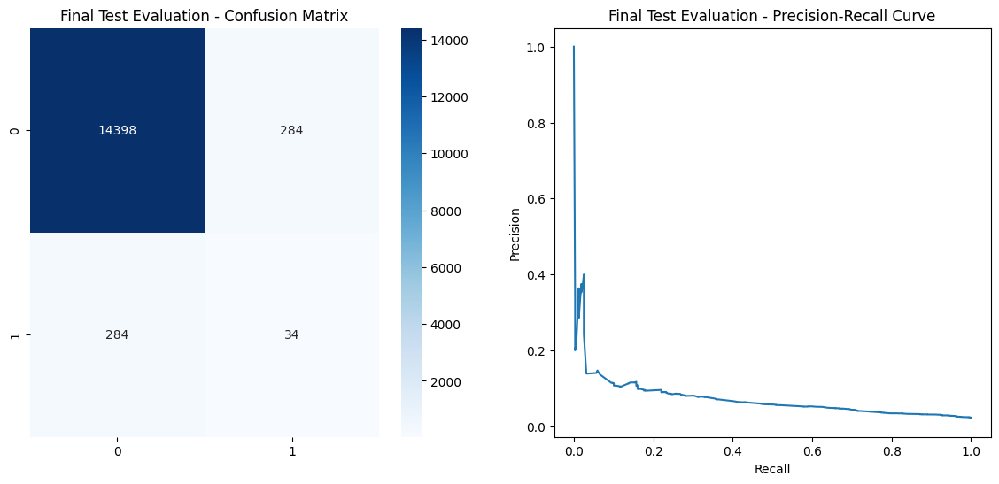

{'roc_auc': np.float64(0.7484374183422307),
 'pr_auc': np.float64(0.07088521721595142),
 'f1': 0.1069182389937107,
 'precision': 0.1069182389937107,
 'recall': 0.1069182389937107}

In [27]:
best_model = models["Logistic Regression"]  # Change as needed
test_proba = best_model.predict_proba(X_test)[:, 1]
test_threshold = find_optimal_threshold(y_test, test_proba, metric='precision_recall_balance')
evaluate_model(best_model, X_test, y_test, threshold=test_threshold, name="Final Test Evaluation")


In [28]:
all_results = [lr_results, rf_results, xgb_results, lgb_results]
best_model_result = max(all_results, key=lambda x: x['pr_auc'])  # Use PR-AUC for imbalanced data
best_model_name = ["Logistic Regression", "Random Forest", "XGBoost", "LightGBM"][all_results.index(best_model_result)]
best_model = best_model_result['model']
best_threshold = best_model_result['threshold']

print(f"\n*** Best model: {best_model_name} with PR-AUC: {best_model_result['pr_auc']:.4f} ***")

# Calibrate the best model (improves probability estimates)
calibrated_model = CalibratedClassifierCV(best_model, cv='prefit')
calibrated_model.fit(X_val, y_val)



*** Best model: Logistic Regression with PR-AUC: 0.0606 ***


CalibratedClassifierCV(cv='prefit',
                       estimator=CalibratedClassifierCV(cv=5,
                                                        estimator=LogisticRegression(C=0.01,
                                                                                     class_weight='balanced',
                                                                                     max_iter=2000,
                                                                                     random_state=42,
                                                                                     solver='saga'),
                                                        method='isotonic'))

Optimal threshold for Calibrated Logistic Regression: 0.0621

Calibrated Logistic Regression - AUC: 0.7451, PR AUC: 0.0606
F1: 0.1196, Precision: 0.0914, Recall: 0.1730
              precision    recall  f1-score   support

           0       0.98      0.96      0.97     14682
           1       0.09      0.17      0.12       318

    accuracy                           0.95     15000
   macro avg       0.54      0.57      0.55     15000
weighted avg       0.96      0.95      0.95     15000



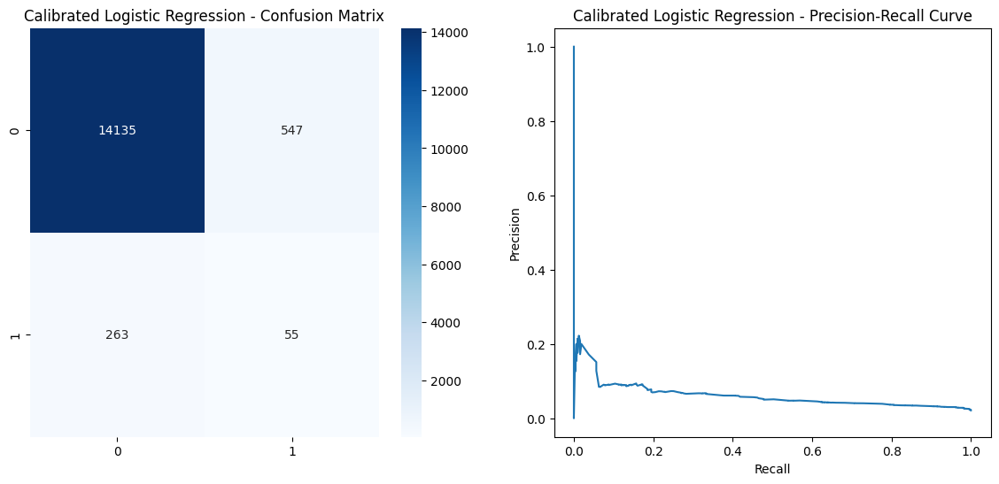


=== Final Evaluation on Test Set ===

Final Logistic Regression - AUC: 0.7484, PR AUC: 0.0709
F1: 0.1245, Precision: 0.0953, Recall: 0.1792
              precision    recall  f1-score   support

           0       0.98      0.96      0.97     14682
           1       0.10      0.18      0.12       318

    accuracy                           0.95     15000
   macro avg       0.54      0.57      0.55     15000
weighted avg       0.96      0.95      0.95     15000



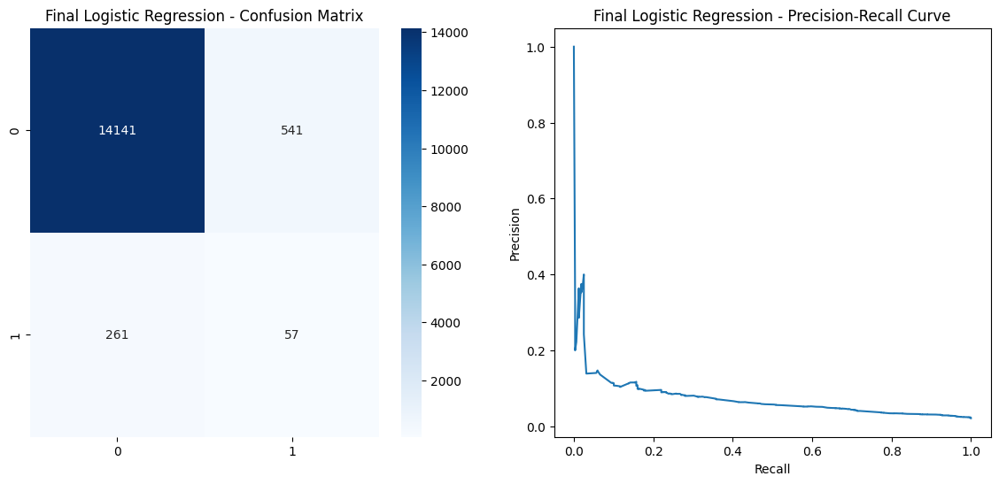

AttributeError: 'CalibratedClassifierCV' object has no attribute 'coef_'

In [29]:
# Find optimal threshold for calibrated model
cal_proba = calibrated_model.predict_proba(X_val)[:, 1]
cal_threshold = find_optimal_threshold(y_val, cal_proba)
print(f"Optimal threshold for Calibrated {best_model_name}: {cal_threshold:.4f}")

# Evaluate the calibrated model
cal_results = evaluate_model(calibrated_model, X_val, y_val, threshold=cal_threshold, name=f"Calibrated {best_model_name}")

# Final evaluation on test set
print("\n=== Final Evaluation on Test Set ===")
final_results = evaluate_model(calibrated_model, X_test, y_test, threshold=cal_threshold, name=f"Final {best_model_name}")

# Feature importance analysis
if best_model_name in ["Random Forest", "XGBoost", "LightGBM"]:
    if best_model_name == "Random Forest":
        importances = best_model.feature_importances_
    elif best_model_name == "XGBoost":
        importances = best_model.feature_importances_
    else:  # LightGBM
        importances = best_model.feature_importances_
        
    feature_importance = pd.DataFrame({'Feature': feature_names, 'Importance': importances})
    feature_importance = feature_importance.sort_values('Importance', ascending=False)
    
    print("\nTop 10 important features:")
    print(feature_importance.head(10))
    
    plt.figure(figsize=(12, 8))
    sns.barplot(x='Importance', y='Feature', data=feature_importance.head(15))
    plt.title(f'Feature Importance from {best_model_name}')
    plt.tight_layout()
    plt.show()
elif best_model_name == "Logistic Regression":
    coefficients = best_model.coef_[0]
    feature_importance = pd.DataFrame({'Feature': feature_names, 'Coefficient': coefficients})
    feature_importance = feature_importance.sort_values('Coefficient', ascending=False)
    
    print("\nTop positive and negative coefficients:")
    print(feature_importance.head(5))  # Top positive
    print(feature_importance.tail(5))  # Top negative
    
    plt.figure(figsize=(12, 8))
    # Plot top 10 features (5 positive, 5 negative)
    top_features = pd.concat([feature_importance.head(8), feature_importance.tail(7)])
    top_features = top_features.sort_values('Coefficient')
    
    colors = ['red' if x < 0 else 'green' for x in top_features['Coefficient']]
    sns.barplot(x='Coefficient', y='Feature', data=top_features, palette=colors)
    plt.axvline(x=0, color='black', linestyle='-', linewidth=0.5)
    plt.title('Feature Coefficients from Logistic Regression')
    plt.tight_layout()
    plt.show()



=== Business Impact Analysis ===
Baseline CTR (random targeting): 2.1190%

Potential impact with model-based targeting:
   targeting_pct  n_selected  selection_pct  prediction_threshold  new_ctr  \
0         1.0000      100000         1.0000                0.0041   0.0212   
1         0.7500       75089         0.7509                0.0065   0.0274   
2         0.5000       50118         0.5012                0.0143   0.0350   
3         0.2500       25072         0.2507                0.0278   0.0485   
4         0.1000       10114         0.1011                0.0456   0.0660   

    lift  
0 1.0000  
1 1.2928  
2 1.6507  
3 2.2888  
4 3.1169  


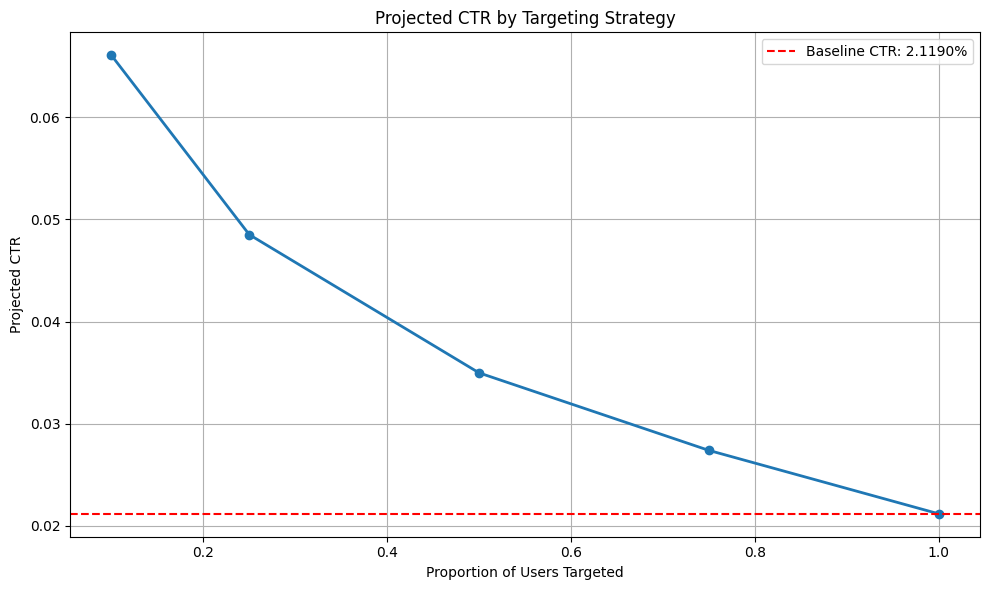

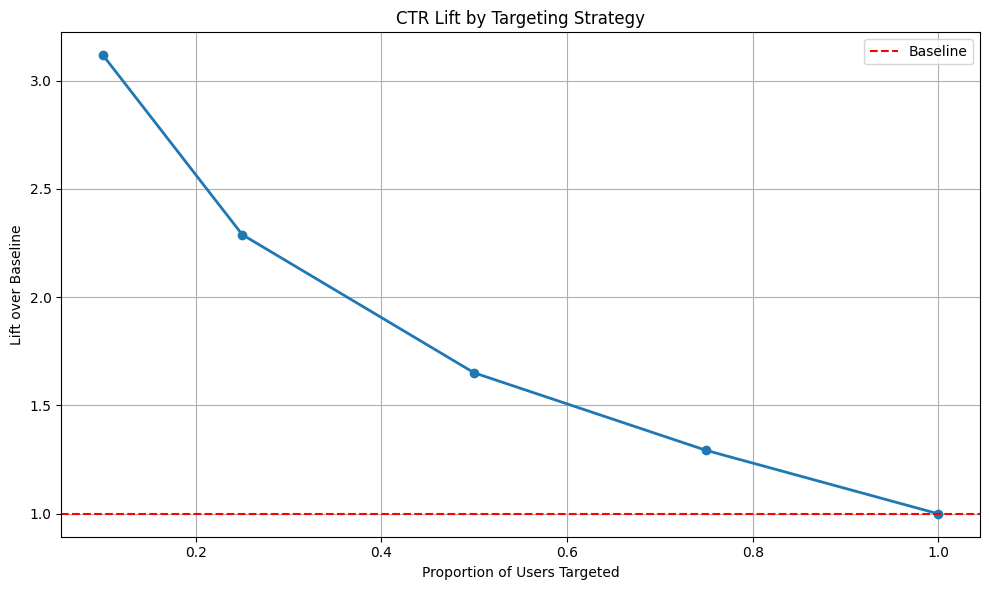

In [30]:
# Business Impact Calculation with Calibrated Model
baseline_ctr = y.mean()

# Calculate potential CTR for different targeting thresholds
def calculate_potential_impact(model, X_processed, y, threshold_percentiles=[1.0, 0.75, 0.5, 0.25, 0.1]):
    """Calculate potential CTR for different targeting strategies"""
    # Get model predictions
    y_pred_proba = model.predict_proba(X_processed)[:, 1]
    
    results = []
    for pct in threshold_percentiles:
        # Get the prediction threshold that would select this proportion of users
        if pct < 1.0:
            # Find threshold that selects top X% of users
            prediction_threshold = np.percentile(y_pred_proba, 100 * (1 - pct))
        else:
            # If targeting everyone, use minimum threshold
            prediction_threshold = min(y_pred_proba) - 0.001
        
        # Select users above this threshold
        selected_indices = y_pred_proba >= prediction_threshold
        
        # Calculate metrics
        selected_ctr = y[selected_indices].mean() if sum(selected_indices) > 0 else 0
        lift = selected_ctr / baseline_ctr if baseline_ctr > 0 else 0
        
        results.append({
            'targeting_pct': pct,
            'n_selected': sum(selected_indices),
            'selection_pct': sum(selected_indices) / len(y),
            'prediction_threshold': prediction_threshold,
            'new_ctr': selected_ctr,
            'lift': lift
        })
    
    return pd.DataFrame(results)

# Calculate impact
impact_df = calculate_potential_impact(calibrated_model, X_processed, y)

# Display results
print("\n=== Business Impact Analysis ===")
print(f"Baseline CTR (random targeting): {baseline_ctr:.4%}")
print("\nPotential impact with model-based targeting:")
pd.set_option('display.float_format', '{:.4f}'.format)
print(impact_df)

# Plot targeting impact
plt.figure(figsize=(10, 6))
plt.plot(impact_df['targeting_pct'], impact_df['new_ctr'], marker='o', linewidth=2)
plt.axhline(y=baseline_ctr, color='r', linestyle='--', label=f'Baseline CTR: {baseline_ctr:.4%}')
plt.xlabel('Proportion of Users Targeted')
plt.ylabel('Projected CTR')
plt.title('Projected CTR by Targeting Strategy')
plt.grid(True)
plt.legend()
plt.tight_layout()
plt.show()

# Plot lift impact
plt.figure(figsize=(10, 6))
plt.plot(impact_df['targeting_pct'], impact_df['lift'], marker='o', linewidth=2)
plt.axhline(y=1.0, color='r', linestyle='--', label='Baseline')
plt.xlabel('Proportion of Users Targeted')
plt.ylabel('Lift over Baseline')
plt.title('CTR Lift by Targeting Strategy')
plt.grid(True)
plt.legend()
plt.tight_layout()
plt.show()

In [31]:
from statsmodels.stats.power import tt_ind_solve_power

def design_ab_test(baseline_ctr, expected_ctr, alpha=0.05, power=0.8):
    """
    Design an A/B test to validate our model improvement
    
    Parameters:
    baseline_ctr: Current click-through rate
    expected_ctr: Expected CTR with model
    alpha: Significance level
    power: Statistical power
    
    Returns:
    required_sample_size: Required sample size per group
    """
    # Calculate effect size using pooled standard deviation
    effect_size = (expected_ctr - baseline_ctr) / np.sqrt(
        (baseline_ctr * (1 - baseline_ctr) + expected_ctr * (1 - expected_ctr)) / 2)
    
    # Calculate required sample size
    sample_size = tt_ind_solve_power(
        effect_size=effect_size, 
        nobs1=None, 
        alpha=alpha, 
        power=power, 
        ratio=1.0, 
        alternative='two-sided'
    )
    
    return int(np.ceil(sample_size))

# Use the 50% targeting strategy for A/B test design
target_pct = 0.5
expected_ctr = impact_df[impact_df['targeting_pct'] == target_pct]['new_ctr'].values[0]
expected_lift = impact_df[impact_df['targeting_pct'] == target_pct]['lift'].values[0]

# Calculate required sample size
sample_size = design_ab_test(baseline_ctr, expected_ctr)

print("\n=== A/B Test Design ===")
print(f"Baseline CTR: {baseline_ctr:.4%}")
print(f"Expected CTR with model (targeting top {target_pct:.0%}): {expected_ctr:.4%}")
print(f"Expected lift: {expected_lift:.2f}x")
print(f"Required sample size per group: {sample_size:,}")
print(f"Total test size: {sample_size*2:,}")

print("\nA/B Test Implementation Plan:")
print("- Group A (Control): Random selection of users")
print("- Group B (Treatment): Top 50% of users as predicted by our model")
print("- Primary metric: Click-through rate")
print(f"- Predicted improvement: {(expected_lift-1)*100:.1f}% more clicks")
print("- Secondary metrics: Open rate, User engagement after click")


=== A/B Test Design ===
Baseline CTR: 2.1190%
Expected CTR with model (targeting top 50%): 3.4977%
Expected lift: 1.65x
Required sample size per group: 2,252
Total test size: 4,504

A/B Test Implementation Plan:
- Group A (Control): Random selection of users
- Group B (Treatment): Top 50% of users as predicted by our model
- Primary metric: Click-through rate
- Predicted improvement: 65.1% more clicks
- Secondary metrics: Open rate, User engagement after click



=== KEY ACTIONABLE INSIGHTS ===
Best sending hours: [23, 24, 10]
Worst sending hours: [18, 20, 21]
Best days to send: ['Wednesday', 'Tuesday']
Email content: short_email performs better
Email personalization: personalized performs better
Country ranking by CTR: ['UK', 'US', 'ES', 'FR']
Purchase segment ranking by CTR: ['10+', '6-10', '4-5', '1-3', '0']
High-value customer threshold: 6.0+ purchases


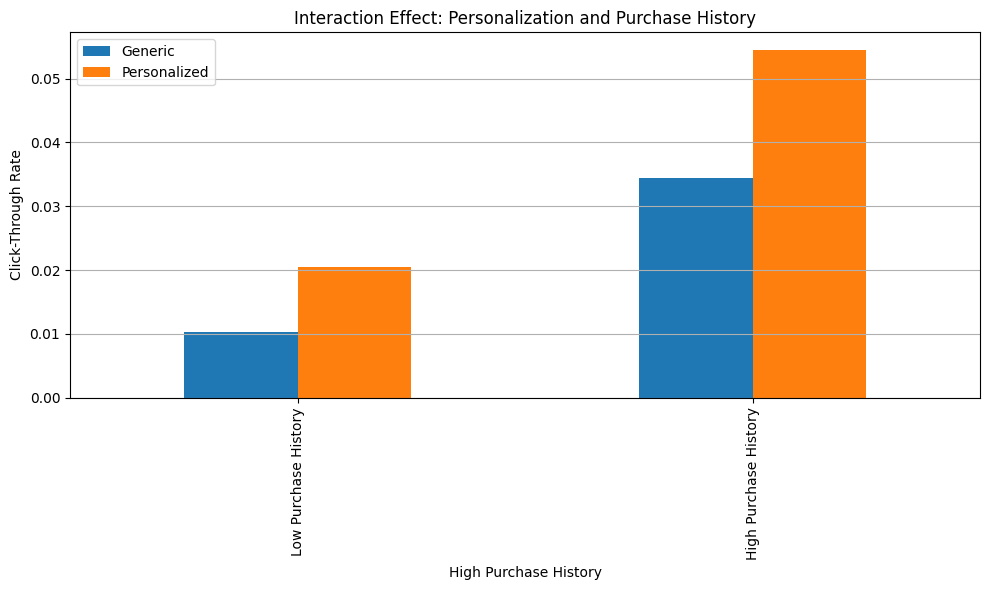


=== FINAL RECOMMENDATIONS ===
1. Targeting Strategy:
   - Use the predictive model to score all users
   - Target the top 50% of users for a 65.1% increase in CTR
   - Focus especially on users with 6.0+ past purchases

2. Email Content Optimization:
   - Use short email format
   - Personalized emails show better performance
   - Especially use personalization for high-value customers

3. Timing Optimization:
   - Send emails between 23:00-11:00
   - Prioritize Wednesday, Tuesday for sends
   - Avoid sending during 18:00-22:00

4. Geographic Targeting:
   - Prioritize users from UK and US
   - Consider country-specific content for these high-performing regions

5. Implementation Plan:
   - Phase 1: Implement the model for 50% of your users
   - Phase 2: A/B test to validate model effectiveness
   - Phase 3: Full deployment with continuous monitoring
   - Phase 4: Refine model with new campaign data


In [32]:
# Extract insights from our dataset and model
def extract_actionable_insights(df, model, feature_names, preprocessor):
    """Extract actionable insights from model and data"""
    insights = {}
    
    # Analyze hour impact
    hour_impact = df.groupby('hour')['clicked'].mean().sort_values(ascending=False)
    best_hours = hour_impact.head(3).index.tolist()
    worst_hours = hour_impact.tail(3).index.tolist()
    insights['best_hours'] = best_hours
    insights['worst_hours'] = worst_hours
    
    # Analyze day impact
    day_impact = df.groupby('weekday')['clicked'].mean().sort_values(ascending=False)
    best_days = day_impact.head(2).index.tolist()
    worst_days = day_impact.tail(2).index.tolist()
    insights['best_days'] = best_days
    insights['worst_days'] = worst_days
    
    # Analyze email content impact
    email_text_impact = df.groupby('email_text')['clicked'].mean()
    insights['better_email_text'] = email_text_impact.idxmax()
    
    # Analyze personalization impact
    personalization_impact = df.groupby('email_version')['clicked'].mean()
    insights['better_personalization'] = personalization_impact.idxmax()
    
    # Analyze country impact
    country_impact = df.groupby('user_country')['clicked'].mean().sort_values(ascending=False)
    insights['country_ranking'] = country_impact.index.tolist()
    
    # Analyze purchase history impact
    # Create purchase segments
    df['purchase_segment'] = pd.cut(
        df['user_past_purchases'], 
        bins=[0, 1, 3, 5, 10, float('inf')],
        labels=['0', '1-3', '4-5', '6-10', '10+']
    )
    purchase_impact = df.groupby('purchase_segment')['clicked'].mean().sort_values(ascending=False)
    insights['purchase_segment_ranking'] = purchase_impact.index.tolist()
    
    # Calculate threshold for high-value customers
    high_value_threshold = df[df['clicked'] == 1]['user_past_purchases'].quantile(0.5)
    insights['high_value_threshold'] = high_value_threshold
    
    # Find interaction effects
    # Email personalization x Purchase history
    interaction_df = df.copy()
    interaction_df['personalized'] = (interaction_df['email_version'] == 'personalized').astype(int)
    interaction_df['high_purchase'] = (interaction_df['user_past_purchases'] > high_value_threshold).astype(int)
    
    # Calculate CTR for different combinations
    segment_results = interaction_df.groupby(['personalized', 'high_purchase'])['clicked'].mean().reset_index()
    segment_results.columns = ['Personalized', 'High_Purchase', 'CTR']
    insights['interaction_effects'] = segment_results
    
    return insights

# Get actionable insights
insights = extract_actionable_insights(df, calibrated_model, feature_names, preprocessor)

# Print key insights
print("\n=== KEY ACTIONABLE INSIGHTS ===")
print(f"Best sending hours: {insights['best_hours']}")
print(f"Worst sending hours: {insights['worst_hours']}")
print(f"Best days to send: {insights['best_days']}")
print(f"Email content: {insights['better_email_text']} performs better")
print(f"Email personalization: {insights['better_personalization']} performs better")
print(f"Country ranking by CTR: {insights['country_ranking']}")
print(f"Purchase segment ranking by CTR: {insights['purchase_segment_ranking']}")
print(f"High-value customer threshold: {insights['high_value_threshold']:.1f}+ purchases")

# Plot interaction effects
interaction_df = insights['interaction_effects'].pivot(index='High_Purchase', columns='Personalized', values='CTR')
plt.figure(figsize=(10, 6))
interaction_df.plot(kind='bar', ax=plt.gca())
plt.title('Interaction Effect: Personalization and Purchase History')
plt.xlabel('High Purchase History')
plt.ylabel('Click-Through Rate')
plt.xticks([0, 1], ['Low Purchase History', 'High Purchase History'])
plt.legend(['Generic', 'Personalized'])
plt.grid(True, axis='y')
plt.tight_layout()
plt.show()

# Final recommendations
print("\n=== FINAL RECOMMENDATIONS ===")
print("1. Targeting Strategy:")
print(f"   - Use the predictive model to score all users")
print(f"   - Target the top 50% of users for a {(expected_lift-1)*100:.1f}% increase in CTR")
print(f"   - Focus especially on users with {insights['high_value_threshold']:.1f}+ past purchases")

print("\n2. Email Content Optimization:")
print(f"   - Use {insights['better_email_text'].replace('_', ' ')} format")
print(f"   - {insights['better_personalization'].capitalize()} emails show better performance")
if insights['interaction_effects'].iloc[1, 1] > insights['interaction_effects'].iloc[1, 0]:
    print(f"   - Especially use personalization for high-value customers")

print("\n3. Timing Optimization:")
print(f"   - Send emails between {insights['best_hours'][0]}:00-{insights['best_hours'][-1] + 1}:00")
print(f"   - Prioritize {', '.join(insights['best_days'])} for sends")
print(f"   - Avoid sending during {insights['worst_hours'][0]}:00-{insights['worst_hours'][-1] + 1}:00")

print("\n4. Geographic Targeting:")
print(f"   - Prioritize users from {insights['country_ranking'][0]} and {insights['country_ranking'][1]}")
print(f"   - Consider country-specific content for these high-performing regions")

print("\n5. Implementation Plan:")
print("   - Phase 1: Implement the model for 50% of your users")
print("   - Phase 2: A/B test to validate model effectiveness")
print("   - Phase 3: Full deployment with continuous monitoring")
print("   - Phase 4: Refine model with new campaign data")